#**Slide in Confusion** - ML Final exam 

### -Leela Alekhya Vedula


##Business Case and Value:

For account balance normally distributed Data and randomly generated gender:
In order to observe the account balances for a paticular day for a group of people with combination of both male and female from different companies and same salaries when the values in the confusion matrix changes. I have applied different distributions on the data to observe these changes. 

So for the above scenario, I have created a synthetic dataset with different functions in it to generate the required data distribution. I want to to create a visualization that accomplishes the above mentioned scenarios. The motto of this is to visualize predicted values vs actual values, show as much of the data as quickly as possible, and quickly get a sense of where the data lies.  That means when to easily depict the confusion matrix on UI change, to see the effect on the data and features distributions , issues of imbalanced data, column counts.


**Steps I followed:**

I have implemented 5 types of data distributions to observe the changes in confusion matrix. They are:
  1. Normal distribution

  2. Exponential distribution

  3. Uniform distribution

  4. Random distribution

  5. Bimodal distribution

Trained the model and run through Muller loop with different classifiers to observe the best classifier and plotted ROC curve

Passed the values through a function such that the interactive confusion matrix is plotted and changed the values of cutoff score on widget slider to see the changes and plotted the comparision table.

Simulated various data (column count , imbalanced data) distributions.

Compared them to see how the data distribution should be changed if we slide the confusion matrix FP up. observed changes in data when we decrease FN and increase FP and whether the algorithm gives best f1 score.




###**Data Narrative:**

The dataset contains details of employees from different companies with same salaries and their account balances when considered for a particular day.

###**Note** : 
When we do not observe change in metrics even after sliding the slider, please run the same cell again to see the results. I have observed that  sometimes, it is not showing changes.

The below is the details of the columns present in the generated dataset

**Name:** This columns denotes name of the employee

**E-mail:** E-mail address of the employee

**Company:** Company in which employee is working

**Gender:** Male and Female genders is considered out of which are denoted in the form of numbers where 0 represents female and 1 represents male

**AccountBalance**: The balance in their accounts considered for a day that varies differently based on the type of data distribution.

In [ ]:
pip install pydbgen

     |████████████████████████████████| 81kB 3.4MB/s 
     |████████████████████████████████| 1.1MB 8.9MB/s 


Imported libraries to create synthetic data

In [ ]:
# import the packages
import pandas as pd
import numpy as np
from pydbgen import pydbgen


# instanciate the faker
faker = pydbgen.pydb()

##Generating fake dataset

In [ ]:
def genName(size = 1):
    return (np.array([faker.fake.name() for i in range(size)]))        # return an array of the specified size of names


def genEmail(size = 1):
    return (np.array([faker.fake.email() for i in range(size)]))       # return an array of the specified size of emails

def genCompany(size = 1):
    return (np.array([faker.fake.company() for i in range(size)]))     # return an array of the specified size of companies

def genGender(size = 1):
  return np.random.choice([0, 1], size=10000, p=[.6, .4])


##Normally distributed data

I have used np.random.normal function to generate normally distributed data

In [ ]:
def genNormAccountBalance(size = 1, m = 690, std = 40):
    arr = np.random.normal(m, std, size).astype(int)                   # generate random integers
    arr = np.clip(arr, 300, 850)                                       # clip respecting boundaries
    return (arr)

In [ ]:
def genDataset(size = 10000):
    data = {'Name': genName(size),
            'Email': genEmail(size),
            'Company': genCompany(size),
            'AccountBalance': genNormAccountBalance(size),
            'Gender': genGender(size)}
    return (pd.DataFrame(data))

# generate the fake data and save the csv and excel files
dfNorm = genDataset()
dfNorm.to_csv('dataset.csv', index = False)

In [ ]:
dfNorm

,Name,Email,Company,AccountBalance,Gender
0,Vanessa Le,ldeleon@thomas-herrera.com,Hudson-Leblanc,735,0
1,Elaine Jordan,qwalker@ingram-allen.org,Jones-Harrington,636,0
2,Melissa Wood,kbennett@gmail.com,Tucker LLC,696,0
3,Pamela James,hmartin@glass.biz,Hernandez Group,635,0
4,Jason Martinez,rclark@kennedy.com,"Woodard, Hill and Robertson",706,1
...,...,...,...,...,...
9995,Daniel Brown,davischristina@hall.biz,"Petersen, Garner and Wheeler",692,1
9996,John Taylor,eross@yahoo.com,Chase-Owens,688,0
9997,Haley Jones,jonesjanice@sanders-roach.info,"Noble, Williams and King",701,1
9998,Mr. Jason Brown,thorne@hotmail.com,Parrish Inc,620,0


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
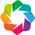

:Scatter   [Gender]   (AccountBalance)

In [ ]:
import pandas as pd
import numpy as np
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

scatter = hv.Scatter(dfNorm,'Gender','AccountBalance')
scatter

###Plotting the normally distributed data in histogram

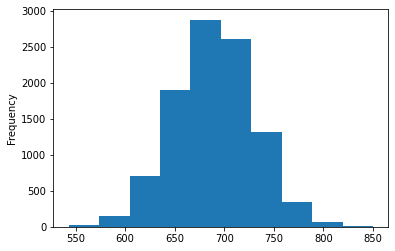

In [ ]:
AccBalance_column = dfNorm["AccountBalance"]
AccBalance_column.plot(kind="hist")

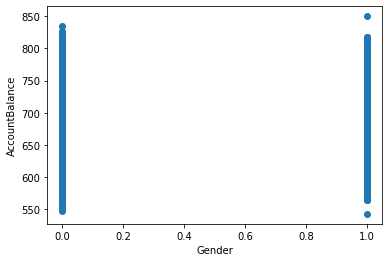

In [ ]:
# Selecting the X axis and Y axis from the data by inserting location of the columns from the data
import numpy as np
import matplotlib.pyplot as plt
X = dfNorm.iloc[:, [3, 4]].values

#Plotting the selected data
plt.scatter(dfNorm['Gender'],dfNorm['AccountBalance'])
plt.xlabel('Gender')
plt.ylabel('AccountBalance')
plt.show()

In [ ]:
target_data = dfNorm.drop(['Name','Email','Company'], axis=1)
target_data

,AccountBalance,Gender
0,735,0
1,636,0
2,696,0
3,635,0
4,706,1
...,...,...
9995,692,1
9996,688,0
9997,701,1
9998,620,0


In [ ]:
unscaled_data = target_data.iloc[:,:-1]
unscaled_data

,AccountBalance
0,735
1,636
2,696
3,635
4,706
...,...
9995,692
9996,688
9997,701
9998,620


In [ ]:
targets=np.array(dfNorm['Gender'])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(unscaled_data)
scaled_inputs = scaler.transform(unscaled_data)
scaled_inputs

array([[ 1.12323759],
       [-1.33466704],
       [ 0.15497213],
       ...,
       [ 0.27910873],
       [-1.73190415],
       [-0.41605622]])

In [ ]:
scaled_inputs.shape

(10000, 1)

###**Applying all classifiers using Muller loop**:


*   K- Nearest Neighbors
*   Linear SVM
*   RBF SVM
*   Gaussian Process
*   Decision Tree
*   Random Forest
*   Neural Net
*   AdaBoost
*   Naive Bayes
*   QDA
*   XGBoost

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier


names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", #"Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA","XGBoost"]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_inputs, targets, train_size = 0.8)
#X_train = np.array(x_train)
#y_train = np.array(y_train)
#x_test = np.array(x_test)
#y_test = np.array(y_test)

In [ ]:
ylabel = dfNorm['Gender'].unique()
ylabels = ["1" if x == 1 else "0" for x in ylabel]
ylabels

['0', '1']

Classifier = Nearest Neighbors, Score (test, accuracy) = 55.70, Training time = 0.11 seconds


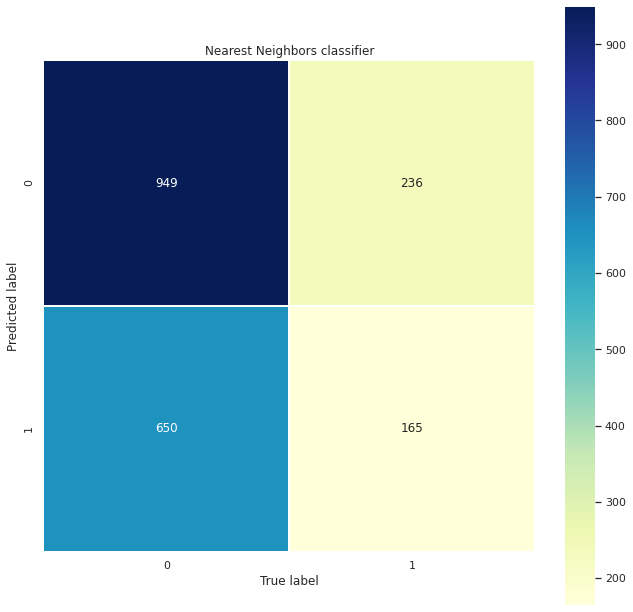

              precision    recall  f1-score   support

           0       0.59      0.80      0.68      1185
           1       0.41      0.20      0.27       815

    accuracy                           0.56      2000
   macro avg       0.50      0.50      0.48      2000
weighted avg       0.52      0.56      0.51      2000

Classifier = Linear SVM, Score (test, accuracy) = 59.25, Training time = 1.31 seconds


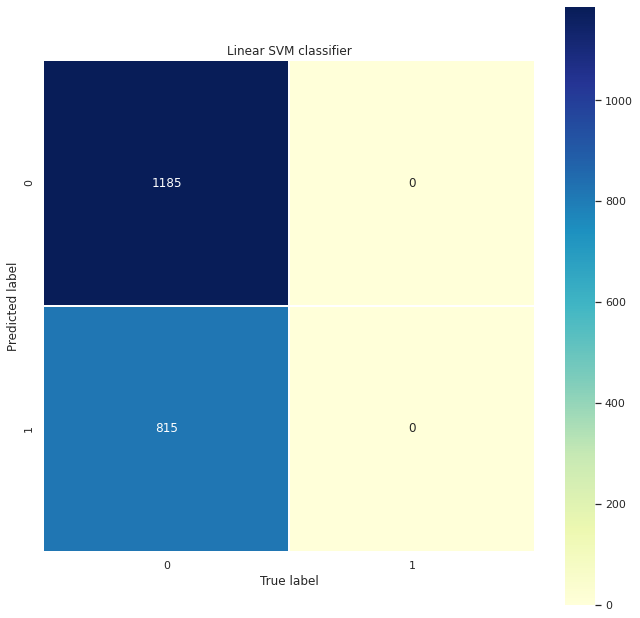

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1185
           1       0.00      0.00      0.00       815

    accuracy                           0.59      2000
   macro avg       0.30      0.50      0.37      2000
weighted avg       0.35      0.59      0.44      2000

Classifier = RBF SVM, Score (test, accuracy) = 59.25, Training time = 2.54 seconds


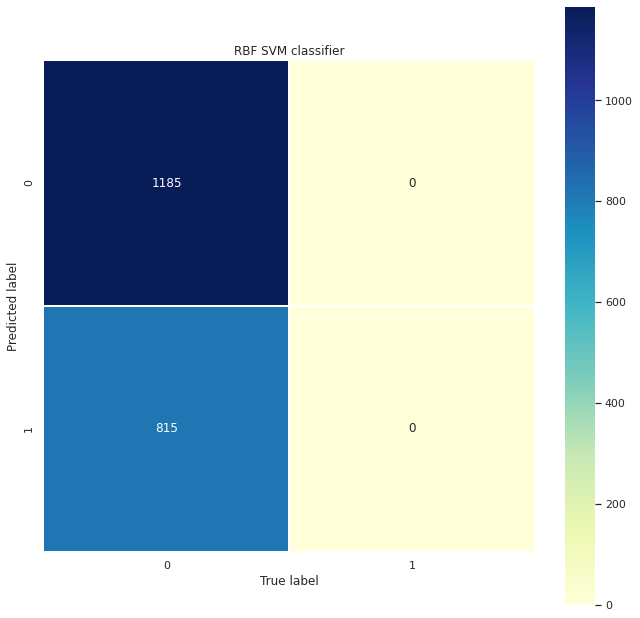

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1185
           1       0.00      0.00      0.00       815

    accuracy                           0.59      2000
   macro avg       0.30      0.50      0.37      2000
weighted avg       0.35      0.59      0.44      2000

Classifier = Decision Tree, Score (test, accuracy) = 59.20, Training time = 0.01 seconds


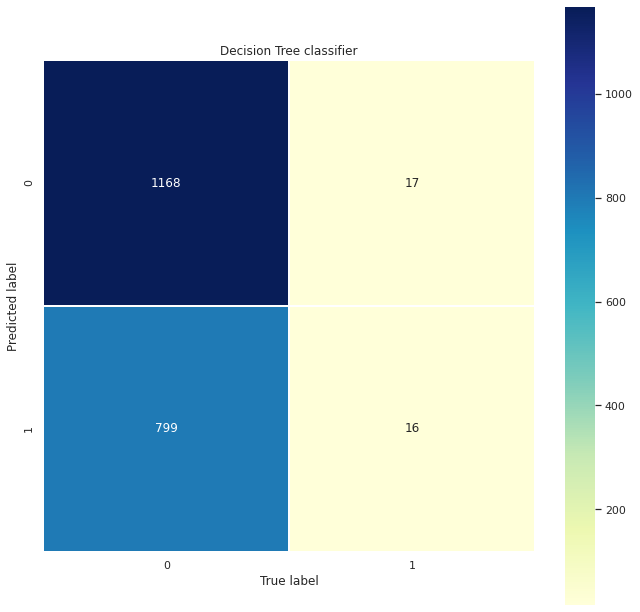

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1185
           1       0.48      0.02      0.04       815

    accuracy                           0.59      2000
   macro avg       0.54      0.50      0.39      2000
weighted avg       0.55      0.59      0.45      2000

Classifier = Random Forest, Score (test, accuracy) = 59.10, Training time = 0.05 seconds


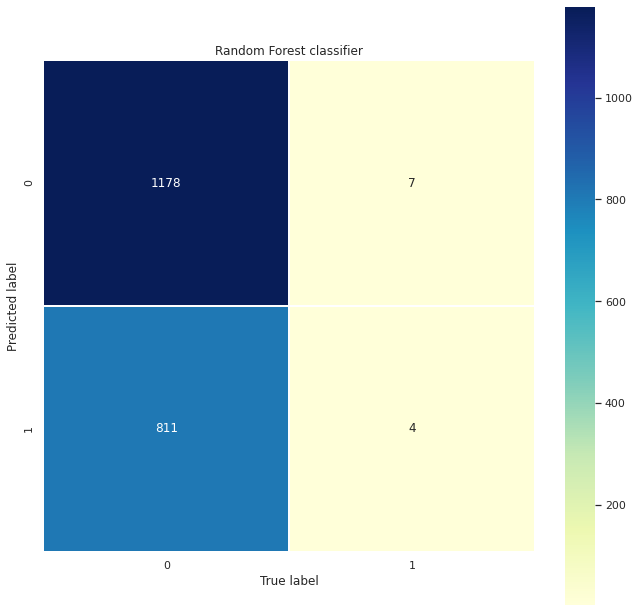

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1185
           1       0.36      0.00      0.01       815

    accuracy                           0.59      2000
   macro avg       0.48      0.50      0.38      2000
weighted avg       0.50      0.59      0.44      2000

Classifier = Neural Net, Score (test, accuracy) = 59.25, Training time = 1.32 seconds


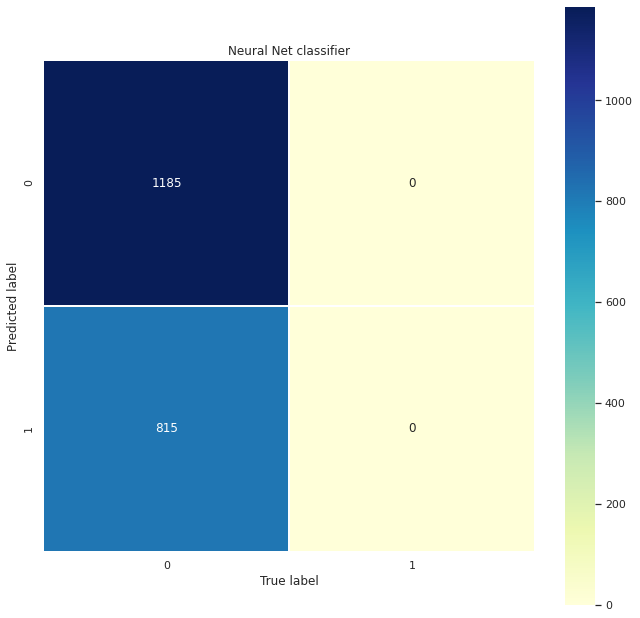

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1185
           1       0.00      0.00      0.00       815

    accuracy                           0.59      2000
   macro avg       0.30      0.50      0.37      2000
weighted avg       0.35      0.59      0.44      2000

Classifier = AdaBoost, Score (test, accuracy) = 59.15, Training time = 0.24 seconds


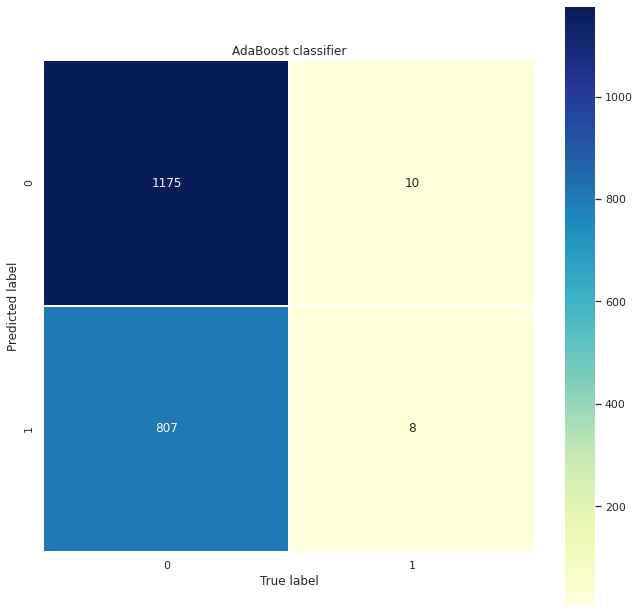

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1185
           1       0.44      0.01      0.02       815

    accuracy                           0.59      2000
   macro avg       0.52      0.50      0.38      2000
weighted avg       0.53      0.59      0.45      2000

Classifier = Naive Bayes, Score (test, accuracy) = 59.25, Training time = 0.00 seconds


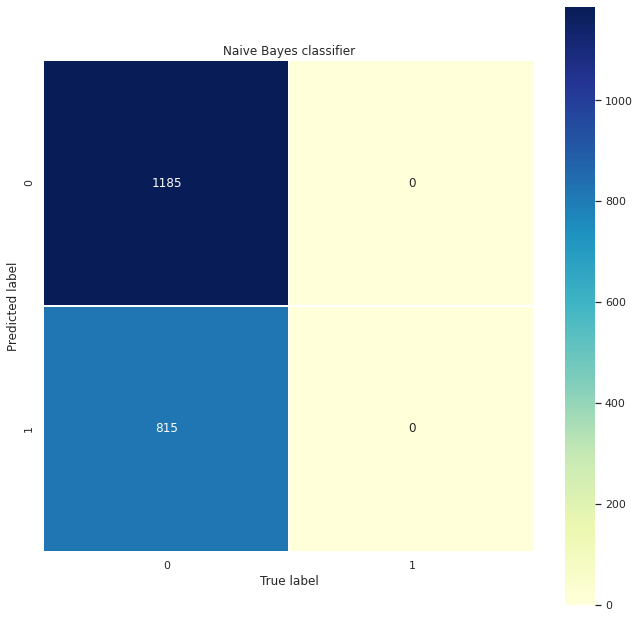

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1185
           1       0.00      0.00      0.00       815

    accuracy                           0.59      2000
   macro avg       0.30      0.50      0.37      2000
weighted avg       0.35      0.59      0.44      2000

Classifier = QDA, Score (test, accuracy) = 59.25, Training time = 0.03 seconds


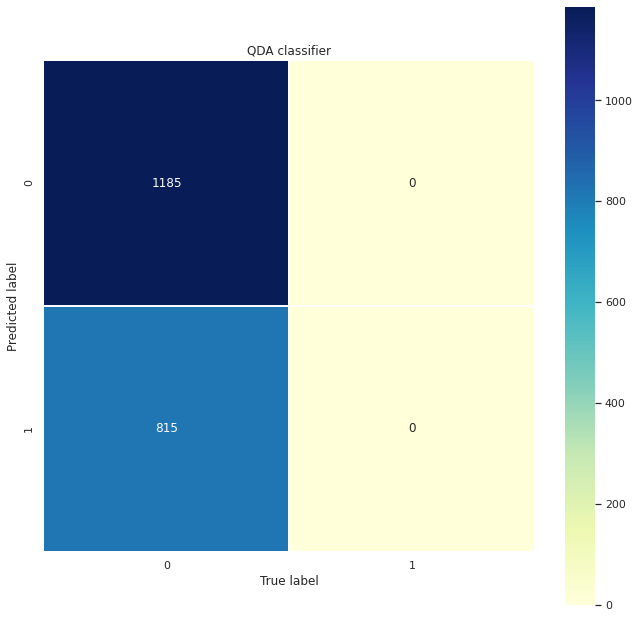

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1185
           1       0.00      0.00      0.00       815

    accuracy                           0.59      2000
   macro avg       0.30      0.50      0.37      2000
weighted avg       0.35      0.59      0.44      2000

Classifier = XGBoost, Score (test, accuracy) = 59.00, Training time = 0.33 seconds


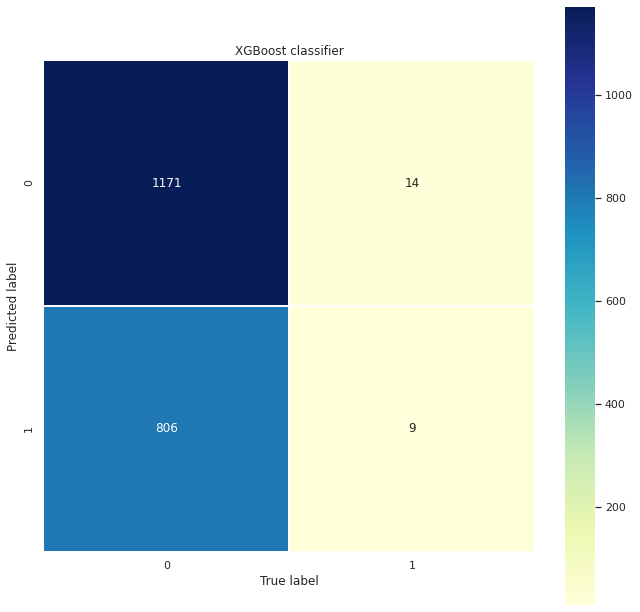

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1185
           1       0.39      0.01      0.02       815

    accuracy                           0.59      2000
   macro avg       0.49      0.50      0.38      2000
weighted avg       0.51      0.59      0.45      2000

--------------------------------------------------------------------------------
Best --> Classifier = Linear SVM, Score (test, accuracy) = 59.25


In [ ]:
import time
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    # GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)]

log_cols=["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)
max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time.time()
    #start_time = datetime.datetime.now().time()
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test) 
    score = 100.0 * clf.score(x_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time.time() - start_time))
    mat_RFC = confusion_matrix(y_test, y_pred)

    fig, ax = plt.subplots(figsize=(11,11))  
    ax.set_title(name + " " +"classifier")
    sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
    plt.xlabel('True label')
    plt.ylabel('Predicted label');
    plt.show()

    cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
    print(cls_RFC)


    
    log_entry = pd.DataFrame([[name,score]], columns=log_cols)
    log = log.append(log_entry)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

Applying Random forest classifier as best classifier

In [ ]:
# Random Forest
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns; sns.set() 
randomforest = RandomForestClassifier()
randomforest.fit(x_train, y_train)
y_pred = randomforest.predict(x_test)
y_pred_proba3 = randomforest.predict_proba(x_test)[:, 1]
acc_randomforest = round(accuracy_score(y_pred, y_test) * 100, 2)
print("Random Forest Accuracy: " ,acc_randomforest)

Random Forest Accuracy:  56.2


###Plotting confusion matrix random forest classifier

              precision    recall  f1-score   support

           0       0.59      0.86      0.70      1185
           1       0.39      0.13      0.19       815

    accuracy                           0.56      2000
   macro avg       0.49      0.49      0.45      2000
weighted avg       0.51      0.56      0.49      2000



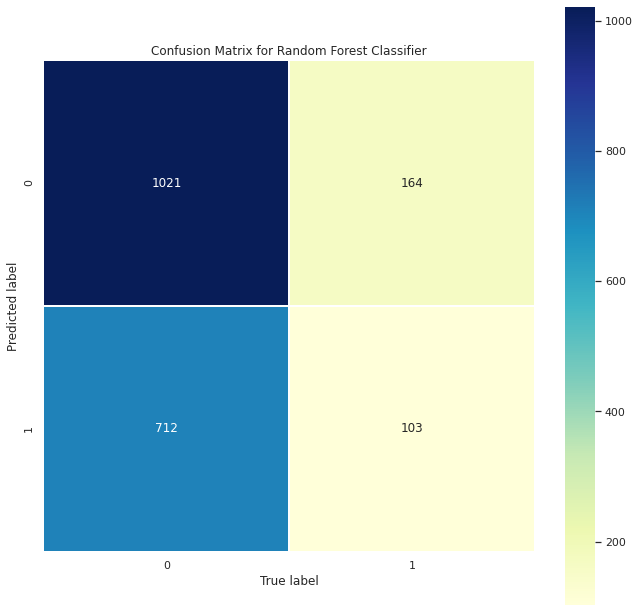

In [ ]:
mat_RFC = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(11,11))  
ax.set_title("Confusion Matrix for Random Forest Classifier")
sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
plt.xlabel('True label')
plt.ylabel('Predicted label');

cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
print(cls_RFC)

###Plotting ROC curve

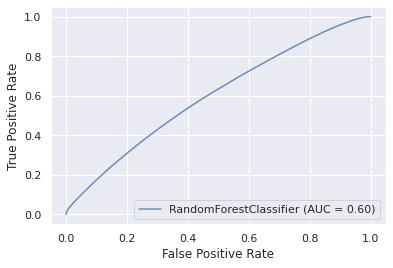

In [ ]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
mat_RFC = plot_roc_curve(randomforest, x_train, y_train, ax=ax, alpha=0.8)
plt.show()

A ROC curve plots the performance of a binary classifier under various threshold settings; this is measured by true positive rate and false positive rate. If your classifier predicts “true” more often, it will have more true positives (good) but also more false positives (bad). If your classifier is more conservative, predicting “true” less often, it will have fewer false positives but fewer true positives as well. The ROC curve is a graphical representation of this tradeoff.

###Installing holoviz library

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()

###Implementing the ClassificationDash function

Using holoviz interactive widgets 

In [ ]:
# ### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
         
    return out
    
# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)

optimal = data[np.argmax(data[:,7])]
# print(data[np.argmax(data[:,7])])

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,809,494,423,274,.62,0.66,.64])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# # for the AUC, we need only plot our FP vs TP
# hv.Curve(data[:,[3,1]]). \
#    opts(xrotation=45,
#         xlabel='False Positive',
#         ylabel='True Positive'
#        )
   

# # for the PR curve, we need only plot recall vs precision
# hv.Curve(data[:,[6,5]]). \
#    opts(xlim=(0,1),
#         ylim=(0,1)
#        )
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        # print("curr_val", curr_val)
        curr_idx = int(curr_val * 1000)
        # print("curr_idx", curr_idx)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))
        # print(data)
        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba3, y_test)
dash.show()


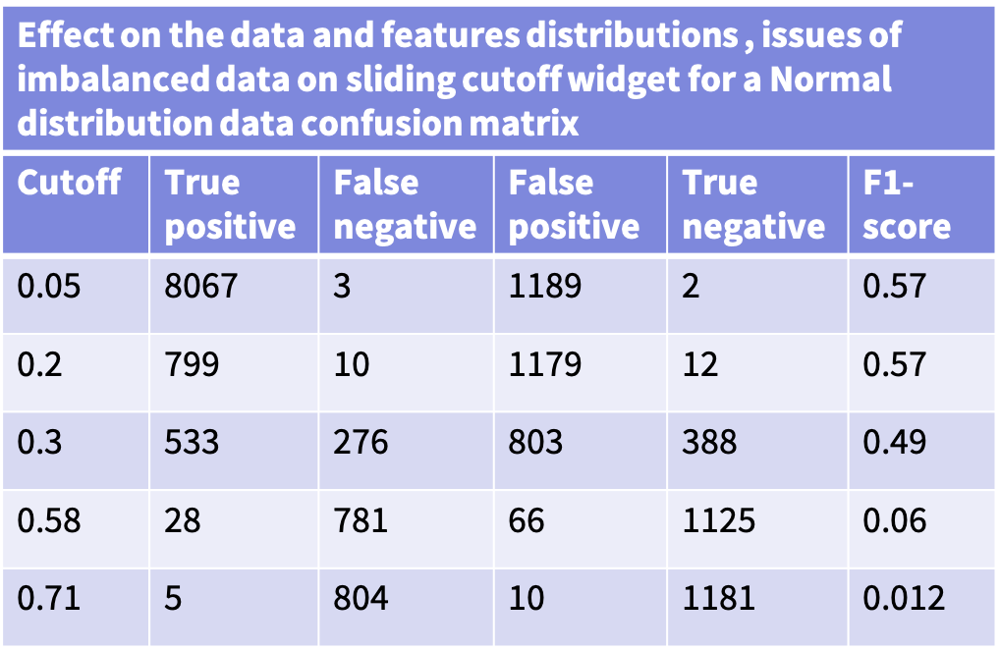

## Exponential data distribution

In [ ]:
def genAccountBalance(size = 1, scale=0.5):
    arr = np.random.exponential(300, 10_000)               # generate random integers
    # arr = np.clip(arr, 300, 850)                                       # clip respecting boundaries
    return (arr)

In [ ]:
def genDataset(size = 10000):
    data = {'Name': genName(size),
            'Email': genEmail(size),
            'Company': genCompany(size),
            'AccountBalance': genAccountBalance(size),
            'Gender': genGender(size)}
    return (pd.DataFrame(data))

# generate the fake data and save the csv and excel files
df = genDataset()
df.to_csv('dataset.csv', index = False)

In [ ]:
df

,Name,Email,Company,AccountBalance,Gender
0,Megan Davis,davisjessica@butler-hopkins.biz,"Jordan, Martinez and Barton",427.470679,1
1,Corey Schmidt MD,cnelson@rice.info,Lewis PLC,19.698508,0
2,Randall Howard,cindy57@crawford.com,Oliver LLC,225.904364,0
3,Steven Green,brandon27@hotmail.com,White-Lucas,405.969946,1
4,Pam Dawson,dwayne51@rowe-walker.com,Gonzalez PLC,1155.163085,0
...,...,...,...,...,...
9995,Steven Clark,alejandro98@bryant.com,Rodriguez-Herrera,122.126098,0
9996,Bradley Watson,brendan80@lawrence-solomon.com,Mitchell-Lam,205.291221,0
9997,Cynthia Moore,golson@yahoo.com,"Jensen, Nguyen and Baker",458.320711,0
9998,Jennifer Delacruz,isaac47@weber.com,"Hudson, Gonzalez and Williams",131.885526,1


Data distribution for account balance column

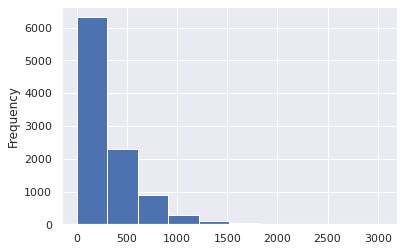

In [ ]:
AccBalance_column = df["AccountBalance"]
AccBalance_column.plot(kind="hist")

In [ ]:
target_data = df.drop(['Name','Email','Company'], axis=1)
target_data

,AccountBalance,Gender
0,427.470679,1
1,19.698508,0
2,225.904364,0
3,405.969946,1
4,1155.163085,0
...,...,...
9995,122.126098,0
9996,205.291221,0
9997,458.320711,0
9998,131.885526,1


In [ ]:
unscaled_data = target_data.iloc[:,:-1]
unscaled_data

,AccountBalance
0,427.470679
1,19.698508
2,225.904364
3,405.969946
4,1155.163085
...,...
9995,122.126098
9996,205.291221
9997,458.320711
9998,131.885526


In [ ]:
targets=np.array(df['Gender'])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(unscaled_data)
scaled_inputs = scaler.transform(unscaled_data)
scaled_inputs

array([[ 0.41217002],
       [-0.93835619],
       [-0.25541009],
       ...,
       [ 0.51434418],
       [-0.56679698],
       [-0.79384988]])

In [ ]:
scaled_inputs.shape

(10000, 1)

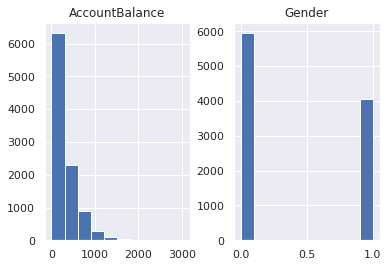

In [ ]:
import matplotlib.pyplot as plt
import pandas
df.hist()
plt.show()

###Applying Muller loop

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier


names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", #"Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA","XGBoost"]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_inputs, targets, train_size = 0.8)
#X_train = np.array(x_train)
#y_train = np.array(y_train)
#x_test = np.array(x_test)
#y_test = np.array(y_test)

In [ ]:
ylabel = df['Gender'].unique()
ylabels = ["1" if x == 1 else "0" for x in ylabel]
ylabels

['1', '0']

Classifier = Nearest Neighbors, Score (test, accuracy) = 57.25, Training time = 0.11 seconds


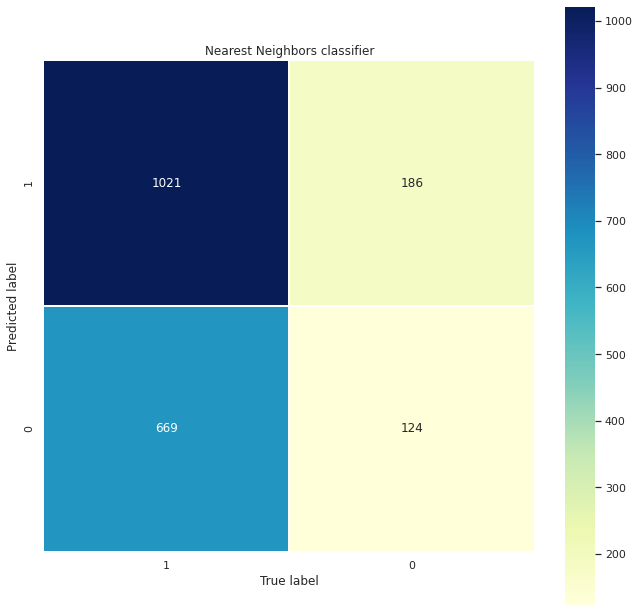

              precision    recall  f1-score   support

           1       0.60      0.85      0.70      1207
           0       0.40      0.16      0.22       793

    accuracy                           0.57      2000
   macro avg       0.50      0.50      0.46      2000
weighted avg       0.52      0.57      0.51      2000

Classifier = Linear SVM, Score (test, accuracy) = 60.35, Training time = 1.20 seconds


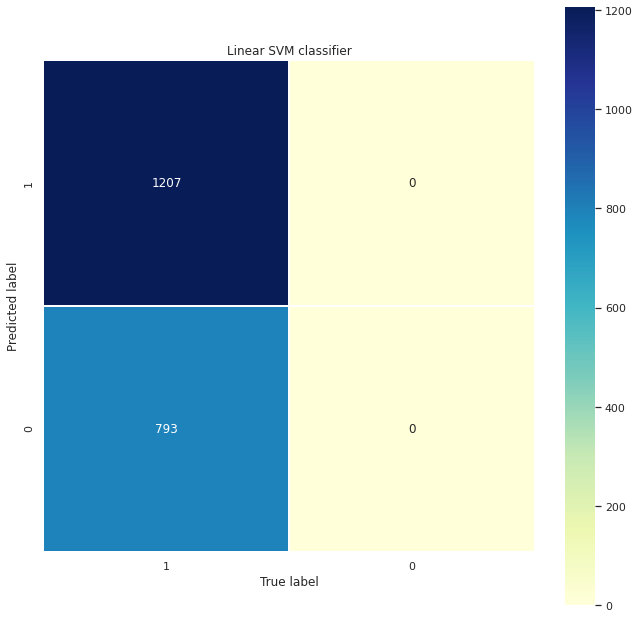

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.00      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = RBF SVM, Score (test, accuracy) = 60.35, Training time = 2.43 seconds


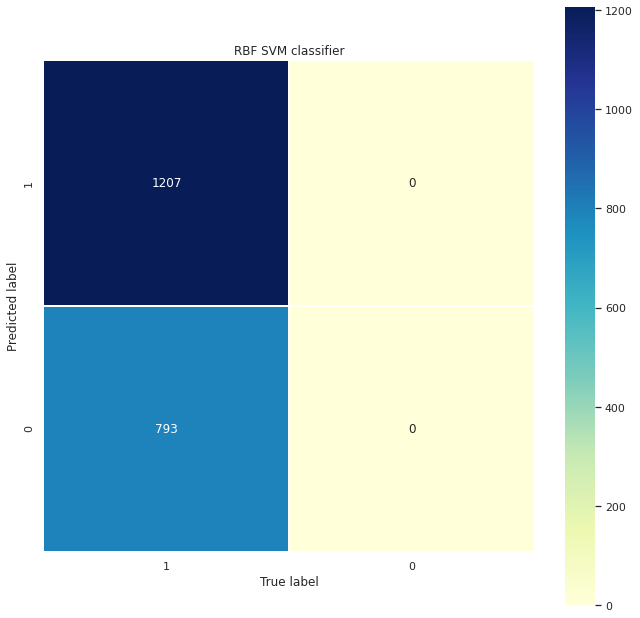

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.00      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = Decision Tree, Score (test, accuracy) = 60.00, Training time = 0.01 seconds


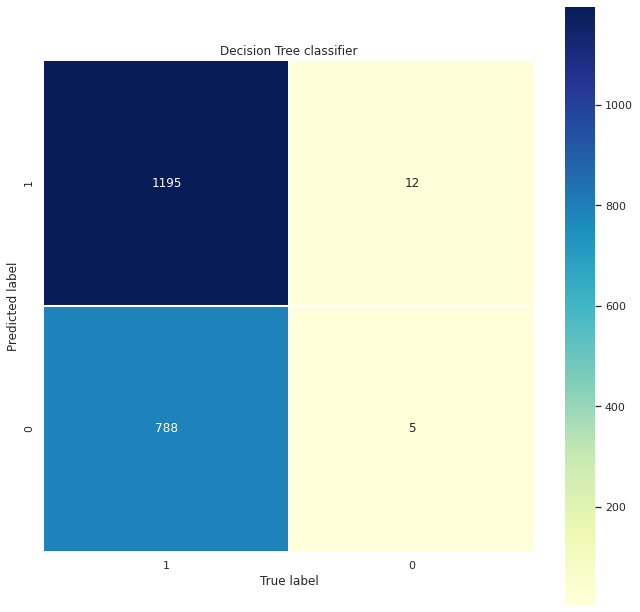

              precision    recall  f1-score   support

           1       0.60      0.99      0.75      1207
           0       0.29      0.01      0.01       793

    accuracy                           0.60      2000
   macro avg       0.45      0.50      0.38      2000
weighted avg       0.48      0.60      0.46      2000

Classifier = Random Forest, Score (test, accuracy) = 60.40, Training time = 0.07 seconds


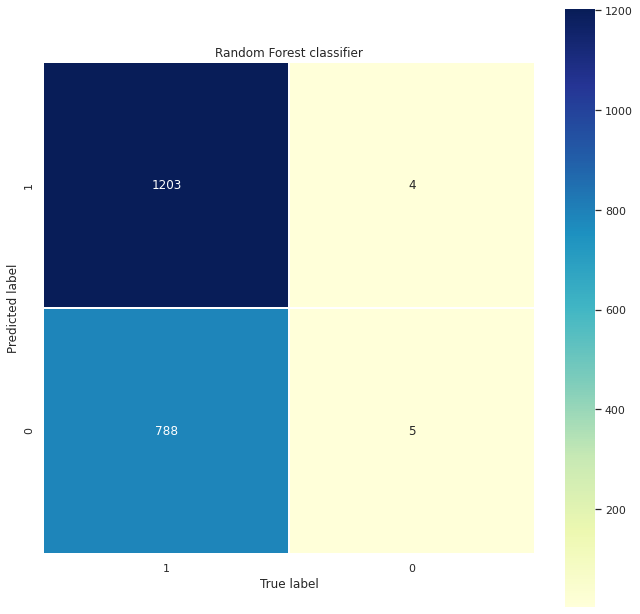

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.56      0.01      0.01       793

    accuracy                           0.60      2000
   macro avg       0.58      0.50      0.38      2000
weighted avg       0.58      0.60      0.46      2000

Classifier = Neural Net, Score (test, accuracy) = 60.35, Training time = 1.55 seconds


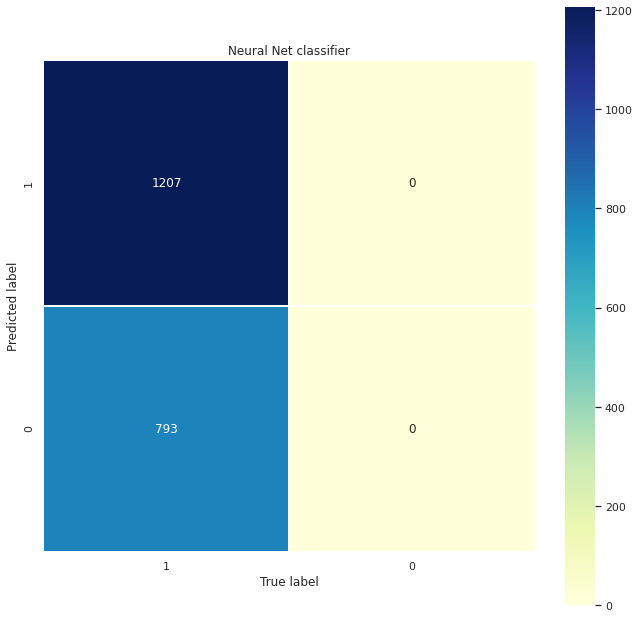

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.00      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = AdaBoost, Score (test, accuracy) = 60.30, Training time = 0.26 seconds


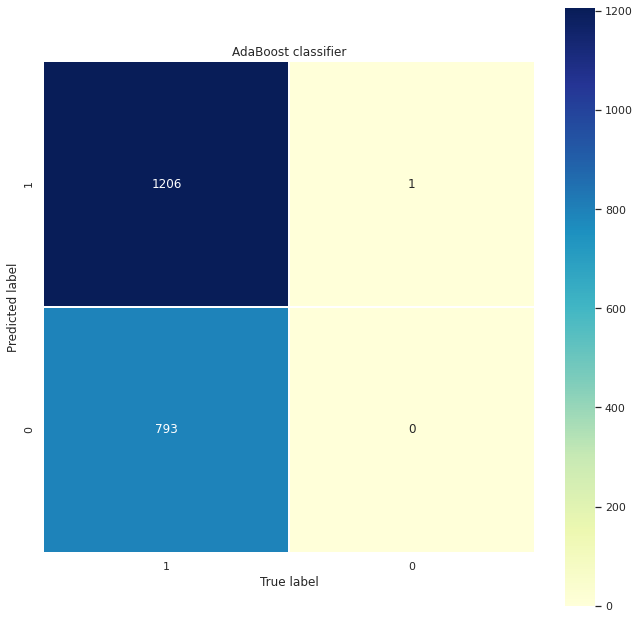

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.00      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = Naive Bayes, Score (test, accuracy) = 60.35, Training time = 0.00 seconds


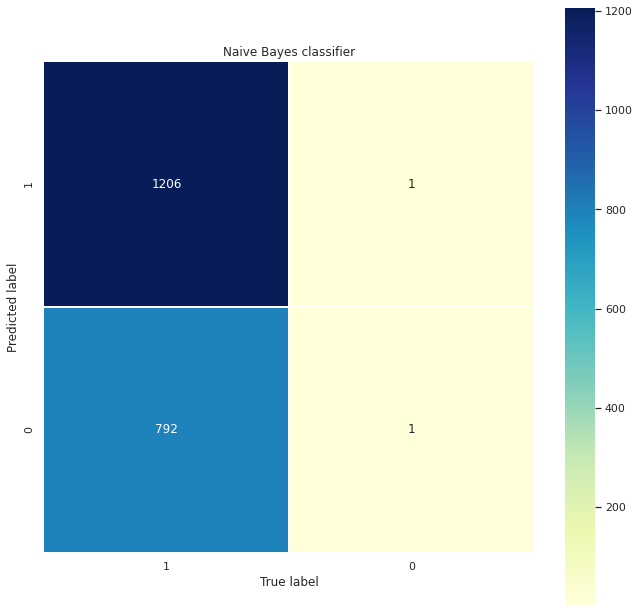

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.50      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.55      0.50      0.38      2000
weighted avg       0.56      0.60      0.46      2000

Classifier = QDA, Score (test, accuracy) = 60.35, Training time = 0.00 seconds


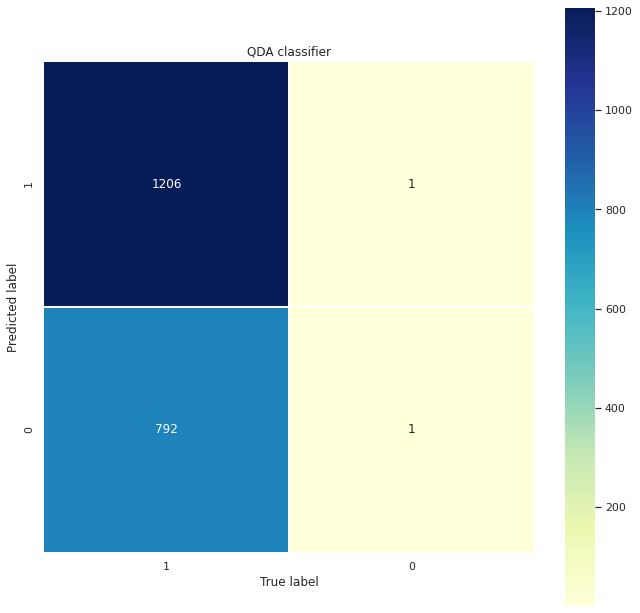

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1207
           0       0.50      0.00      0.00       793

    accuracy                           0.60      2000
   macro avg       0.55      0.50      0.38      2000
weighted avg       0.56      0.60      0.46      2000

Classifier = XGBoost, Score (test, accuracy) = 59.75, Training time = 0.24 seconds


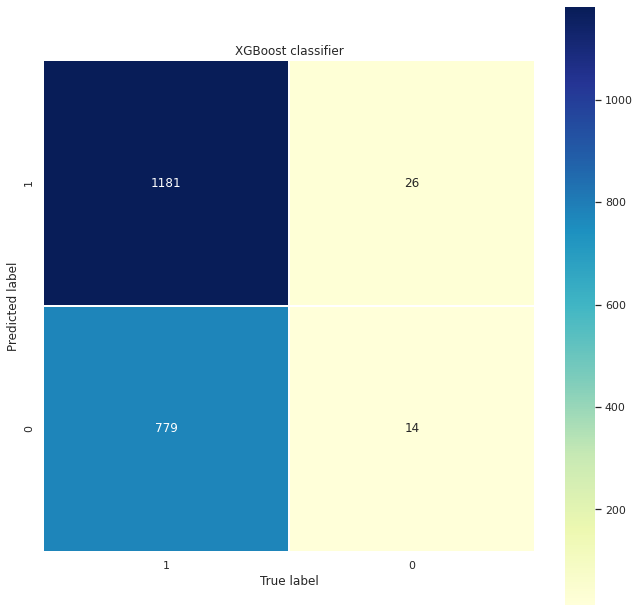

              precision    recall  f1-score   support

           1       0.60      0.98      0.75      1207
           0       0.35      0.02      0.03       793

    accuracy                           0.60      2000
   macro avg       0.48      0.50      0.39      2000
weighted avg       0.50      0.60      0.46      2000

--------------------------------------------------------------------------------
Best --> Classifier = Random Forest, Score (test, accuracy) = 60.40


In [ ]:
import time
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    # GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)]

log_cols=["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)
max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time.time()
    #start_time = datetime.datetime.now().time()
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test) 
    score = 100.0 * clf.score(x_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time.time() - start_time))
    mat_RFC = confusion_matrix(y_test, y_pred)

    fig, ax = plt.subplots(figsize=(11,11))  
    ax.set_title(name + " " +"classifier")
    sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
    plt.xlabel('True label')
    plt.ylabel('Predicted label');
    plt.show()

    cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
    print(cls_RFC)


    
    log_entry = pd.DataFrame([[name,score]], columns=log_cols)
    log = log.append(log_entry)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

For Random forest classifier

In [ ]:
# Random Forest
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
randomforest = RandomForestClassifier()
randomforest.fit(x_train, y_train)
y_pred = randomforest.predict(x_test)
y_pred_proba5 = randomforest.predict_proba(x_test)[:, 1]
acc_randomforest = round(accuracy_score(y_pred, y_test) * 100, 2)
print("Random Forest Accuracy: " ,acc_randomforest)

Random Forest Accuracy:  51.65


              precision    recall  f1-score   support

           1       0.60      0.59      0.59      1207
           0       0.39      0.41      0.40       793

    accuracy                           0.52      2000
   macro avg       0.50      0.50      0.50      2000
weighted avg       0.52      0.52      0.52      2000



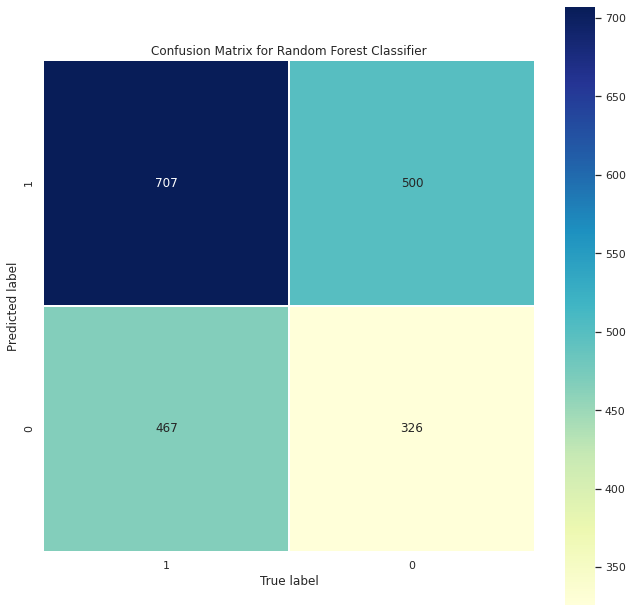

In [ ]:
mat_RFC = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(11,11))  
ax.set_title("Confusion Matrix for Random Forest Classifier")
sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
plt.xlabel('True label')
plt.ylabel('Predicted label');

cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
print(cls_RFC)

###Roc curve

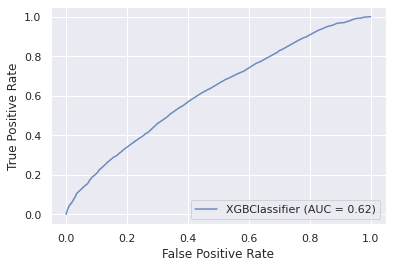

In [ ]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
mat_RFC = plot_roc_curve(clf, x_train, y_train, ax=ax, alpha=0.8)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
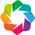

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
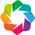

:Curve   [x]   (y)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.0001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
       
    return out

# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)
optimal = data[np.argmax(data[:,7])]

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,320,480,482,718,.60,0.58,.59])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# for the AUC, we need only plot our FP vs TP
hv.Curve(data[:]). \
   opts(xrotation=45,
        xlabel='False Positive',
        ylabel='True Positive'
       )
   
# for the PR curve, we need only plot recall vs precision
hv.Curve(data[:,[6,5]]). \
   opts(xlim=(0,1),
        ylim=(0,1)
       )

There is more data present for Female(0) than for Male(1)

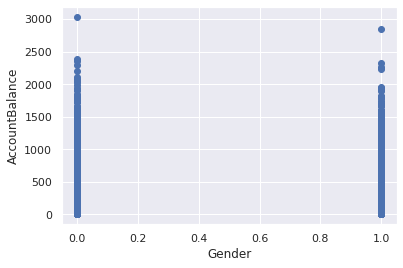

In [ ]:
# Selecting the X axis and Y axis from the data by inserting location of the columns from the data
X = df.iloc[:, [3, 4]].values

#Plotting the selected data
plt.scatter(df['Gender'],df['AccountBalance'])
plt.xlabel('Gender')
plt.ylabel('AccountBalance')
plt.show()



###Slider implementation

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
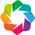

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba5, y_test)
dash.show()

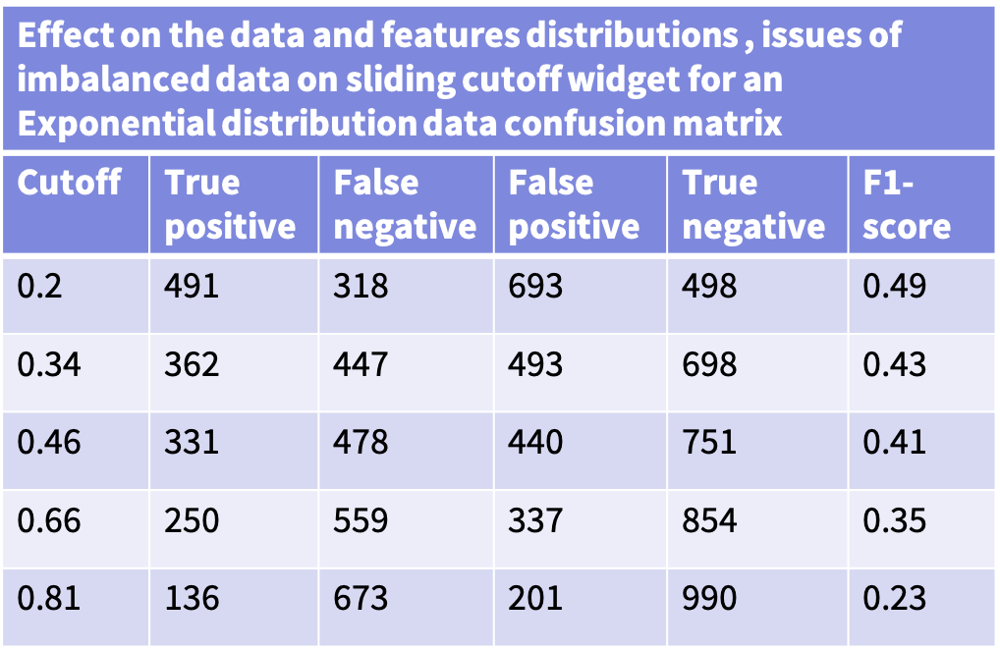

##Uniformly distributed data of account balance column

In [ ]:
def genUniAccountBalance(size = 2, low = 300, high = 850):
    arr = np.random.uniform(low,high,size)                  # generate random integers
    arr = np.clip(arr, 300, 850)                                       # clip respecting boundaries
    return (arr)

In [ ]:
def genDataset(size = 10000):
    data = {'Name': genName(size),
            'Email': genEmail(size),
            'Company': genCompany(size),
            'AccountBalance': genUniAccountBalance(size),
            'Gender': genGender(size)}
    return (pd.DataFrame(data))

# generate the fake data and save the csv and excel files
dfUni = genDataset()
dfUni.to_csv('dataset.csv', index = False)

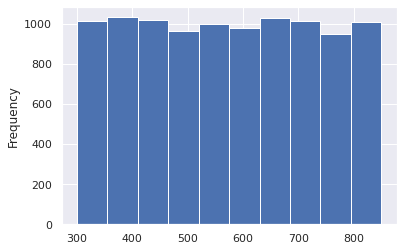

In [ ]:
AccBalance_column = dfUni["AccountBalance"]
AccBalance_column.plot(kind="hist")

###Scattered plot that shows plots of account balance present in male and female counts

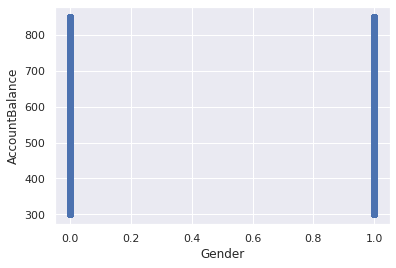

In [ ]:
# Selecting the X axis and Y axis from the data by inserting location of the columns from the data
X = dfUni.iloc[:, [3, 4]].values

#Plotting the selected data
plt.scatter(dfUni['Gender'],dfUni['AccountBalance'])
plt.xlabel('Gender')
plt.ylabel('AccountBalance')
plt.show()

In [ ]:
target_data = dfUni.drop(['Name','Email','Company'], axis=1)
target_data

,AccountBalance,Gender
0,401.039205,0
1,546.256549,1
2,677.122633,1
3,445.676281,0
4,444.438606,0
...,...,...
9995,563.393077,0
9996,368.300965,1
9997,481.715833,0
9998,618.935649,1


In [ ]:
unscaled_data = target_data.iloc[:,:-1]
unscaled_data

,AccountBalance
0,401.039205
1,546.256549
2,677.122633
3,445.676281
4,444.438606
...,...
9995,563.393077
9996,368.300965
9997,481.715833
9998,618.935649


In [ ]:
targets=np.array(dfUni['Gender'])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(unscaled_data)
scaled_inputs = scaler.transform(unscaled_data)
scaled_inputs

array([[-1.0865435 ],
       [-0.17173068],
       [ 0.65267479],
       ...,
       [-0.5783121 ],
       [ 0.2861194 ],
       [ 1.52945361]])

In [ ]:
scaled_inputs.shape

(10000, 1)

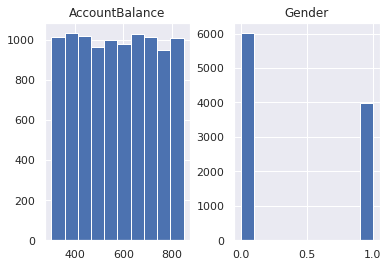

In [ ]:
import matplotlib.pyplot as plt
import pandas
dfUni.hist()
plt.show()

###Applying Muller loop

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier


names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", #"Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA","XGBoost"]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_inputs, targets, train_size = 0.8)
#X_train = np.array(x_train)
#y_train = np.array(y_train)
#x_test = np.array(x_test)
#y_test = np.array(y_test)

In [ ]:
ylabel = df['Gender'].unique()
ylabels = ["1" if x == 1 else "0" for x in ylabel]
ylabels

['1', '0']

Classifier = Nearest Neighbors, Score (test, accuracy) = 57.00, Training time = 0.11 seconds


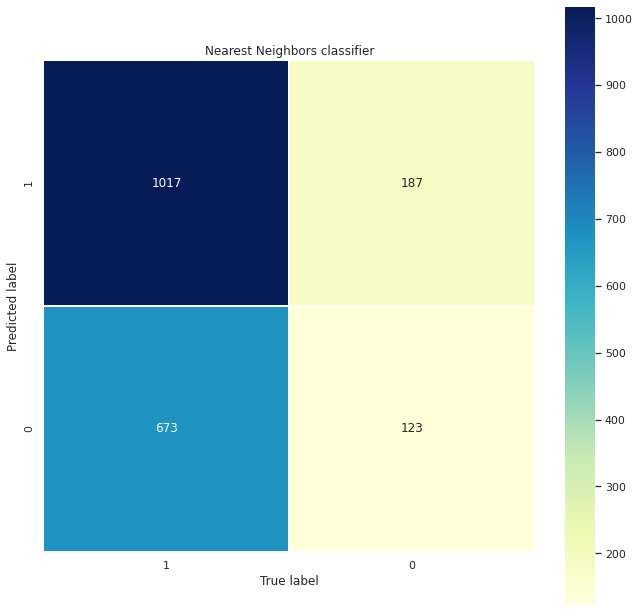

              precision    recall  f1-score   support

           1       0.60      0.84      0.70      1204
           0       0.40      0.15      0.22       796

    accuracy                           0.57      2000
   macro avg       0.50      0.50      0.46      2000
weighted avg       0.52      0.57      0.51      2000

Classifier = Linear SVM, Score (test, accuracy) = 60.20, Training time = 1.20 seconds


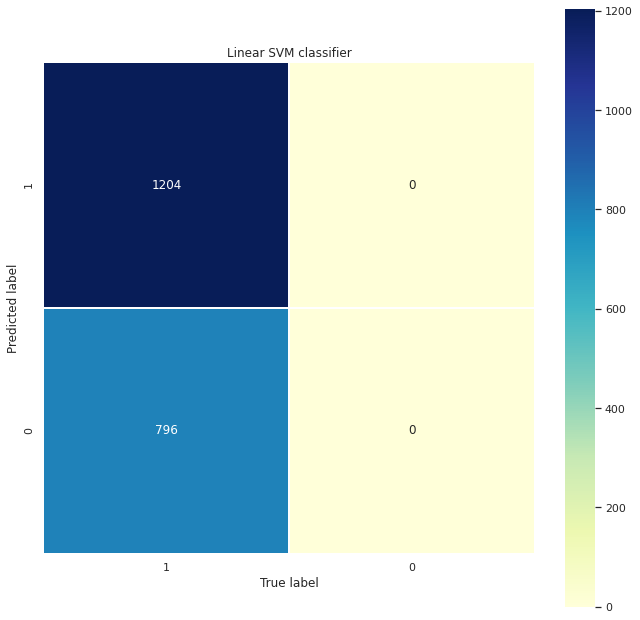

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.00      0.00      0.00       796

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = RBF SVM, Score (test, accuracy) = 60.20, Training time = 2.50 seconds


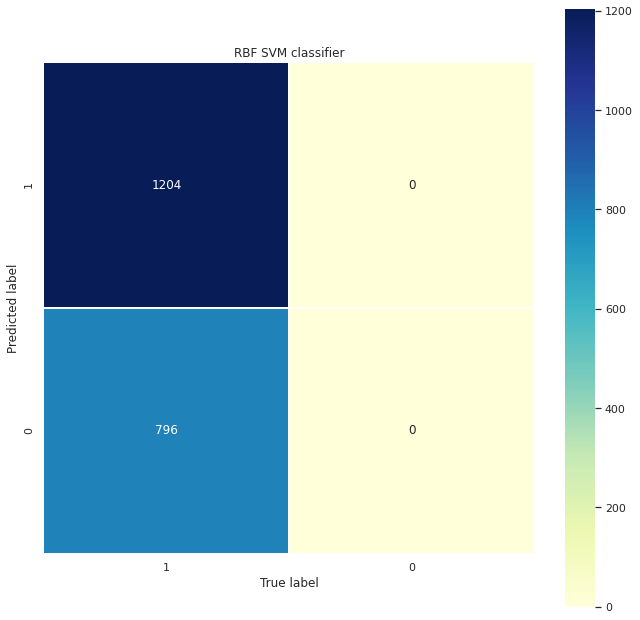

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.00      0.00      0.00       796

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = Decision Tree, Score (test, accuracy) = 60.30, Training time = 0.01 seconds


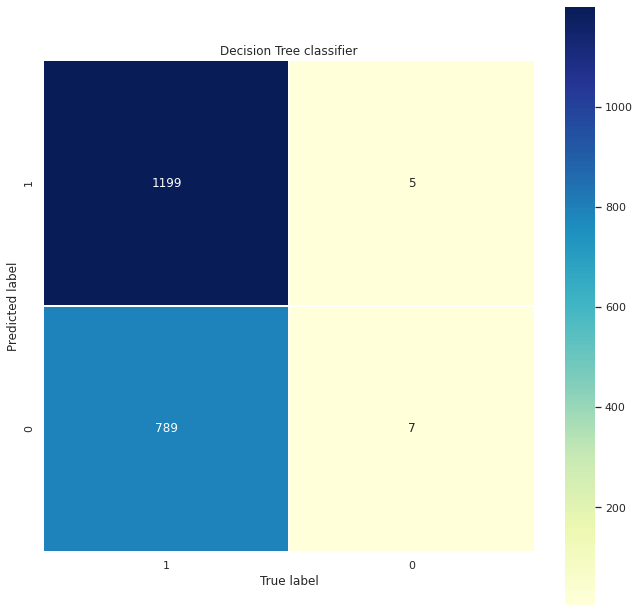

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.58      0.01      0.02       796

    accuracy                           0.60      2000
   macro avg       0.59      0.50      0.38      2000
weighted avg       0.60      0.60      0.46      2000

Classifier = Random Forest, Score (test, accuracy) = 60.20, Training time = 0.06 seconds


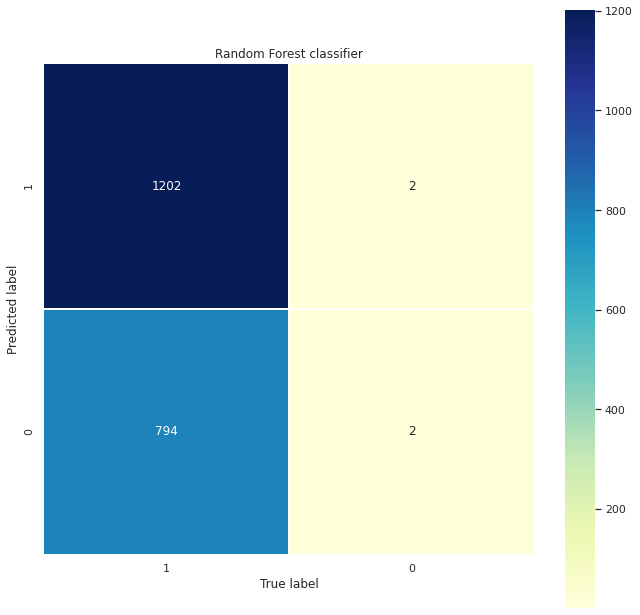

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.50      0.00      0.01       796

    accuracy                           0.60      2000
   macro avg       0.55      0.50      0.38      2000
weighted avg       0.56      0.60      0.45      2000

Classifier = Neural Net, Score (test, accuracy) = 60.20, Training time = 1.59 seconds


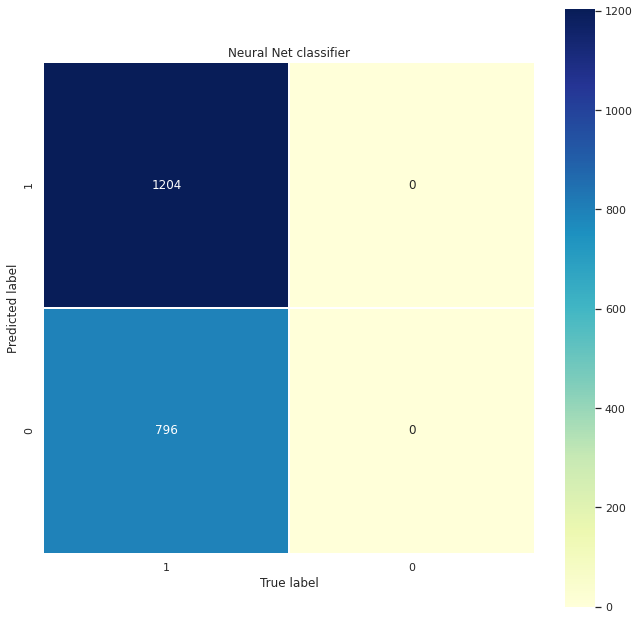

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.00      0.00      0.00       796

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = AdaBoost, Score (test, accuracy) = 60.25, Training time = 0.29 seconds


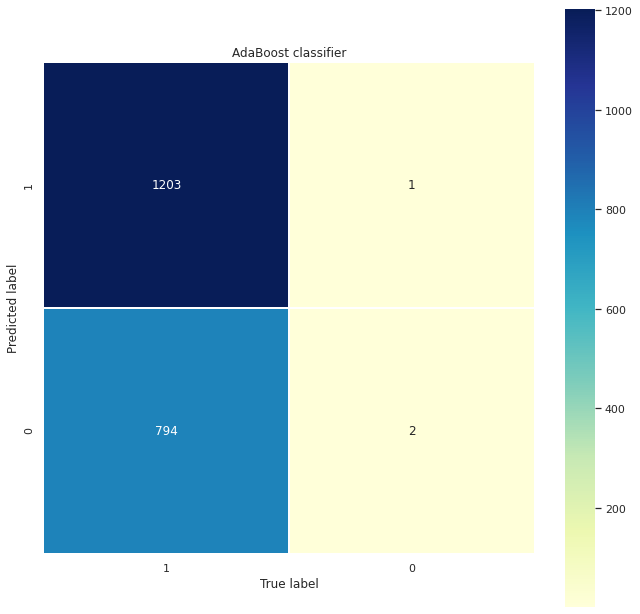

              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.67      0.00      0.01       796

    accuracy                           0.60      2000
   macro avg       0.63      0.50      0.38      2000
weighted avg       0.63      0.60      0.45      2000

Classifier = Naive Bayes, Score (test, accuracy) = 60.20, Training time = 0.00 seconds


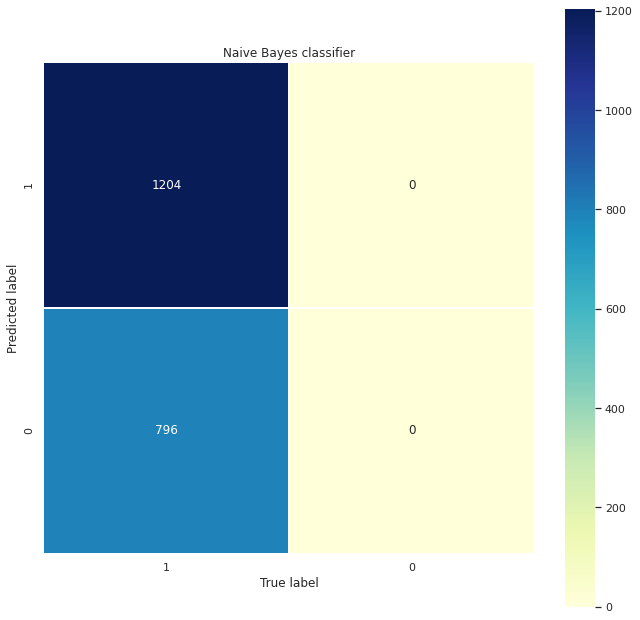

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.00      0.00      0.00       796

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = QDA, Score (test, accuracy) = 60.20, Training time = 0.00 seconds


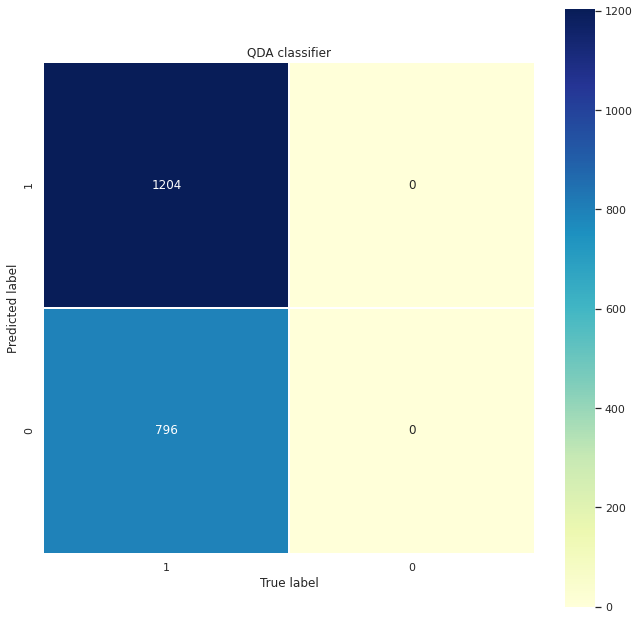

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           1       0.60      1.00      0.75      1204
           0       0.00      0.00      0.00       796

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = XGBoost, Score (test, accuracy) = 59.85, Training time = 0.25 seconds


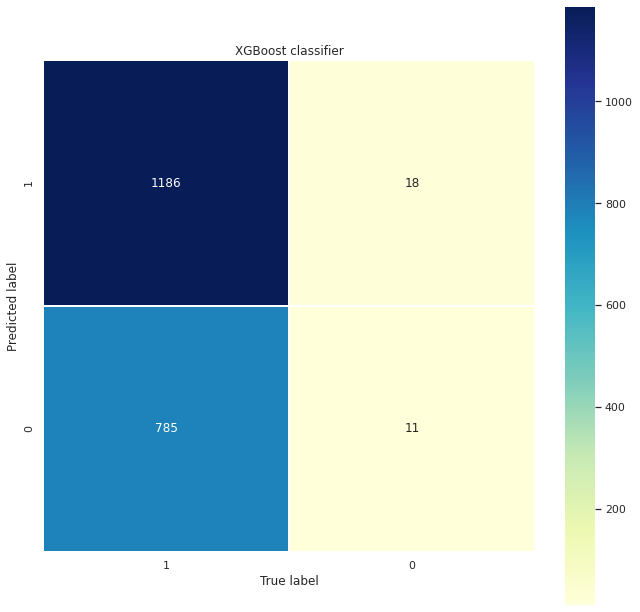

              precision    recall  f1-score   support

           1       0.60      0.99      0.75      1204
           0       0.38      0.01      0.03       796

    accuracy                           0.60      2000
   macro avg       0.49      0.50      0.39      2000
weighted avg       0.51      0.60      0.46      2000

--------------------------------------------------------------------------------
Best --> Classifier = Decision Tree, Score (test, accuracy) = 60.30


In [ ]:
import time
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    # GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)]

log_cols=["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)
max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time.time()
    #start_time = datetime.datetime.now().time()
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test) 
    score = 100.0 * clf.score(x_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time.time() - start_time))
    mat_RFC = confusion_matrix(y_test, y_pred)

    fig, ax = plt.subplots(figsize=(11,11))  
    ax.set_title(name + " " +"classifier")
    sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
    plt.xlabel('True label')
    plt.ylabel('Predicted label');
    plt.show()

    cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
    print(cls_RFC)


    
    log_entry = pd.DataFrame([[name,score]], columns=log_cols)
    log = log.append(log_entry)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

For Random forest classifier

In [ ]:
# Random Forest
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
randomforest = RandomForestClassifier()
randomforest.fit(x_train, y_train)
y_pred = randomforest.predict(x_test)
y_pred_proba2 = randomforest.predict_proba(x_test)[:, 1]
acc_randomforest = round(accuracy_score(y_pred, y_test) * 100, 2)
print("Random Forest Accuracy: " ,acc_randomforest)

Random Forest Accuracy:  51.1


              precision    recall  f1-score   support

           1       0.59      0.60      0.60      1204
           0       0.38      0.38      0.38       796

    accuracy                           0.51      2000
   macro avg       0.49      0.49      0.49      2000
weighted avg       0.51      0.51      0.51      2000



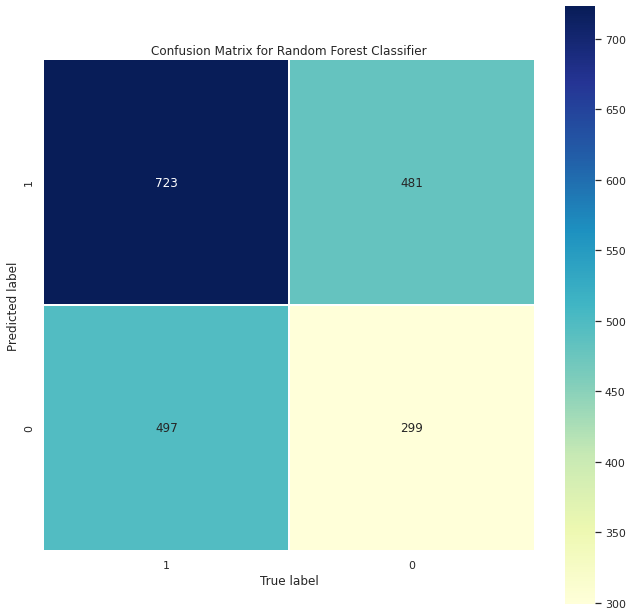

In [ ]:
mat_RFC = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(11,11))  
ax.set_title("Confusion Matrix for Random Forest Classifier")
sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
plt.xlabel('True label')
plt.ylabel('Predicted label');

cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
print(cls_RFC)

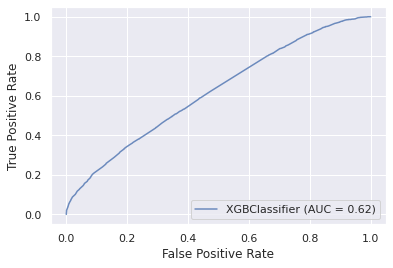

In [ ]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
mat_RFC = plot_roc_curve(clf, x_train, y_train, ax=ax, alpha=0.8)
plt.show()

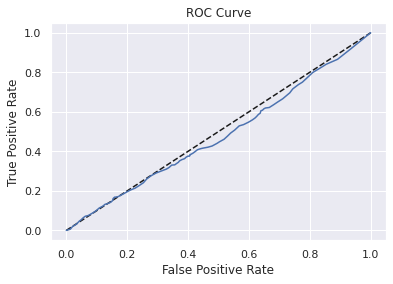

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba2, pos_label=1)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
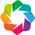

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()

In [ ]:
### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
       
    return out

# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)
optimal = data[np.argmax(data[:,7])]

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,715,482,480,323,.60,0.60,.60])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# for the AUC, we need only plot our FP vs TP
hv.Curve(data[:]). \
   opts(xrotation=45,
        xlabel='False Positive',
        ylabel='True Positive'
       )
   
# for the PR curve, we need only plot recall vs precision
hv.Curve(data[:,[6,5]]). \
   opts(xlim=(0,1),
        ylim=(0,1)
       )

:Curve   [x]   (y)

###Slider for uniformly distributed confusion matrix

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
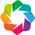

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba2, y_test)
dash.show()

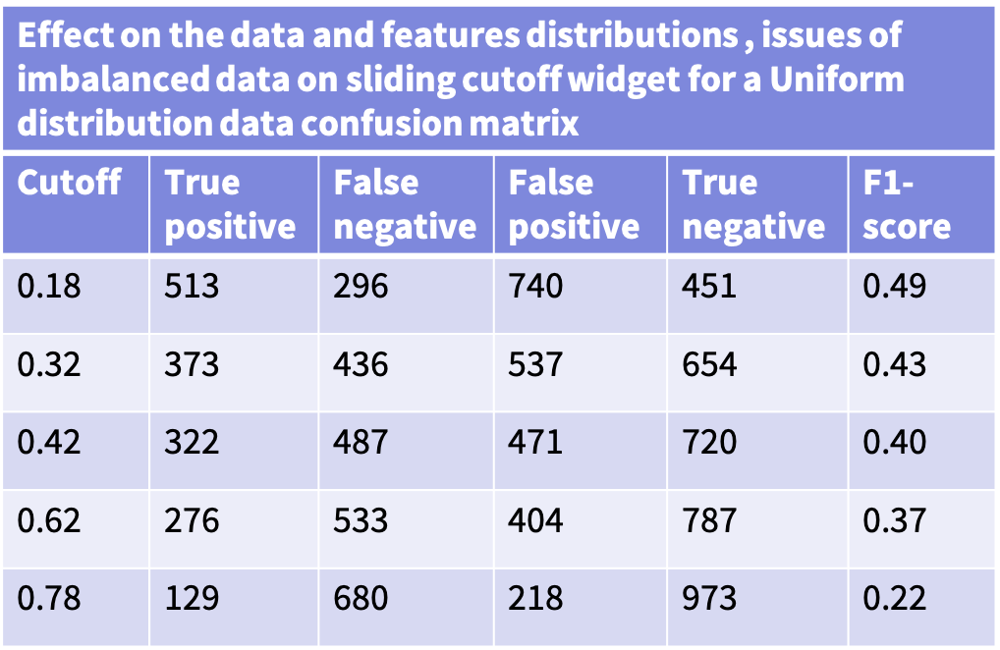

##Bimodal Distribution data for account balance column

In [ ]:
def genAccountBalance(size=1):
  size=5000
  mu, sigma = 700, 60
  mu2, sigma2 = 450, 80
  X1 = np.random.normal(mu, sigma, size)
  X2 = np.random.normal(mu2, sigma2, size)
  X = np.concatenate([X1, X2])
  # plt.hist(X)
    # arr = np.random.poisson(lam, size).astype(int)                  # generate random integers
    # arr = np.clip(arr, 300, 850)                                       # clip respecting boundaries
  return X

In [ ]:
def genDataset(size = 10000):
    data = {'Name': genName(size),
            'Email': genEmail(size),
            'Company': genCompany(size),
            'AccountBalance': genAccountBalance(size),
            'Gender': genGender(size)}
    return (pd.DataFrame(data))

# generate the fake data and save the csv and excel files
df = genDataset()
df.to_csv('dataset.csv', index = False)

In [ ]:
df

,Name,Email,Company,AccountBalance,Gender
0,Arthur Anderson,christophermoore@lewis.com,"House, Marquez and Perez",707.201424,0
1,Mason Anderson,jmorris@hotmail.com,Cervantes-Chan,747.780879,0
2,Beth Kirby,hschwartz@west-stanley.com,Guerrero-Howard,726.780319,0
3,Peter Smith,rangeldavid@russo.biz,Smith-White,607.060405,0
4,David Scott,hannah93@tapia.com,"Green, Rodriguez and Esparza",789.440697,0
...,...,...,...,...,...
9995,Michael Rice,sallywest@hotmail.com,Phillips-Hess,385.592768,0
9996,Scott Graham,pwilliams@hughes.net,"Huynh, Noble and Lewis",531.905849,1
9997,Kevin Henson,robertanderson@jackson-smith.info,Bryan-Wilson,430.796361,0
9998,Rachel Matthews,jennifer76@gmail.com,Mcneil-Martin,320.434157,1


Bimodal Distribution

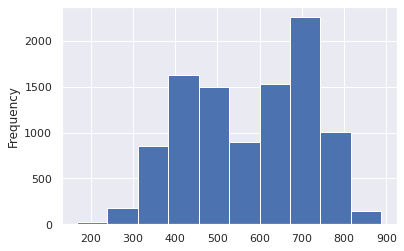

In [ ]:
AccBalance_column = df["AccountBalance"]
AccBalance_column.plot(kind="hist")

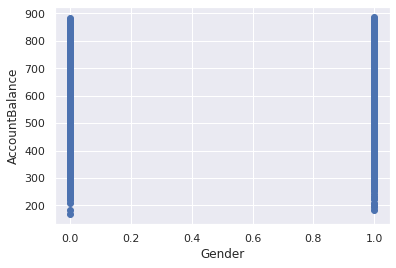

In [ ]:
# Selecting the X axis and Y axis from the data by inserting location of the columns from the data
X = df.iloc[:, [3, 4]].values

#Plotting the selected data
plt.scatter(df['Gender'],df['AccountBalance'])
plt.xlabel('Gender')
plt.ylabel('AccountBalance')
plt.show()

In [ ]:
target_data = df.drop(['Name','Email','Company'], axis=1)
target_data

,AccountBalance,Gender
0,707.201424,0
1,747.780879,0
2,726.780319,0
3,607.060405,0
4,789.440697,0
...,...,...
9995,385.592768,0
9996,531.905849,1
9997,430.796361,0
9998,320.434157,1


In [ ]:
unscaled_data = target_data.iloc[:,:-1]
unscaled_data

,AccountBalance
0,707.201424
1,747.780879
2,726.780319
3,607.060405
4,789.440697
...,...
9995,385.592768
9996,531.905849
9997,430.796361
9998,320.434157


In [ ]:
targets=np.array(df['Gender'])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(unscaled_data)
scaled_inputs = scaler.transform(unscaled_data)
scaled_inputs

array([[ 0.92105402],
       [ 1.20359664],
       [ 1.05737602],
       ...,
       [-1.00347182],
       [-1.77189086],
       [-0.39715022]])

In [ ]:
scaled_inputs.shape

(10000, 1)

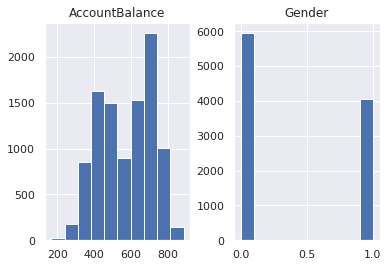

In [ ]:
import matplotlib.pyplot as plt
import pandas
df.hist()
plt.show()

###Applying Muller loop with all classifiers

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier


names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", #"Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA","XGBoost"]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_inputs, targets, train_size = 0.8)
#X_train = np.array(x_train)
#y_train = np.array(y_train)
#x_test = np.array(x_test)
#y_test = np.array(y_test)

In [ ]:
ylabel = df['Gender'].unique()
ylabels = ["1" if x == 1 else "0" for x in ylabel]
ylabels

['0', '1']

Classifier = Nearest Neighbors, Score (test, accuracy) = 54.90, Training time = 0.11 seconds


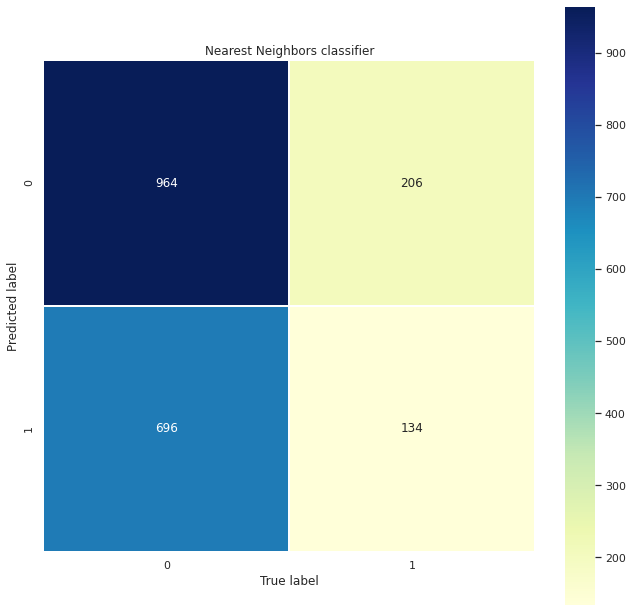

              precision    recall  f1-score   support

           0       0.58      0.82      0.68      1170
           1       0.39      0.16      0.23       830

    accuracy                           0.55      2000
   macro avg       0.49      0.49      0.46      2000
weighted avg       0.50      0.55      0.49      2000

Classifier = Linear SVM, Score (test, accuracy) = 58.50, Training time = 1.14 seconds


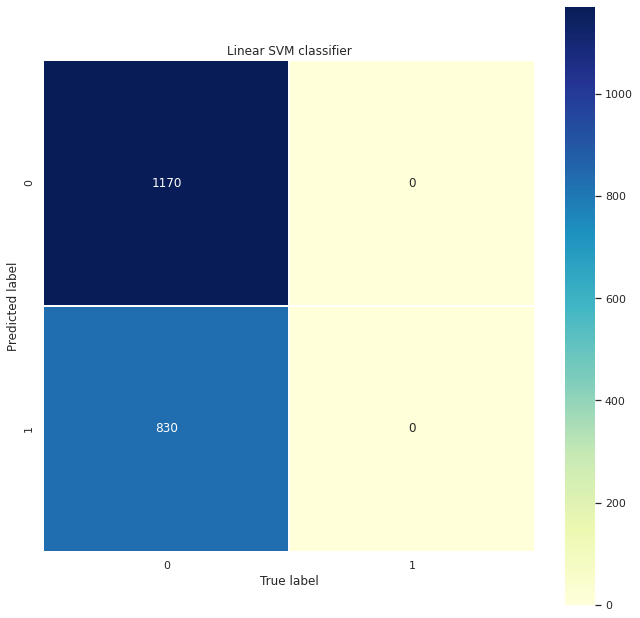

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.58      1.00      0.74      1170
           1       0.00      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.29      0.50      0.37      2000
weighted avg       0.34      0.58      0.43      2000

Classifier = RBF SVM, Score (test, accuracy) = 58.50, Training time = 2.71 seconds


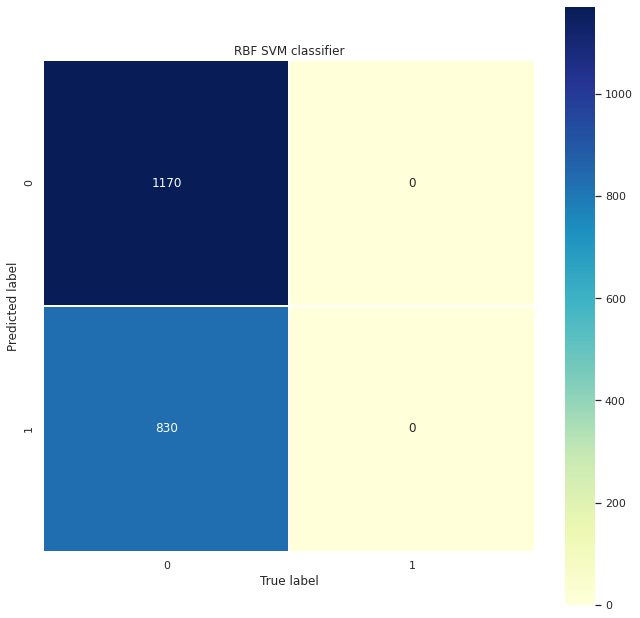

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.58      1.00      0.74      1170
           1       0.00      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.29      0.50      0.37      2000
weighted avg       0.34      0.58      0.43      2000

Classifier = Decision Tree, Score (test, accuracy) = 58.25, Training time = 0.01 seconds


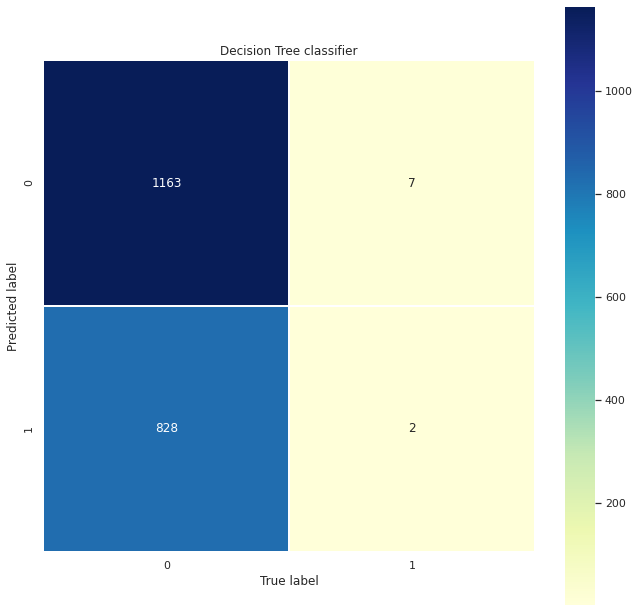

              precision    recall  f1-score   support

           0       0.58      0.99      0.74      1170
           1       0.22      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.40      0.50      0.37      2000
weighted avg       0.43      0.58      0.43      2000

Classifier = Random Forest, Score (test, accuracy) = 58.40, Training time = 0.07 seconds


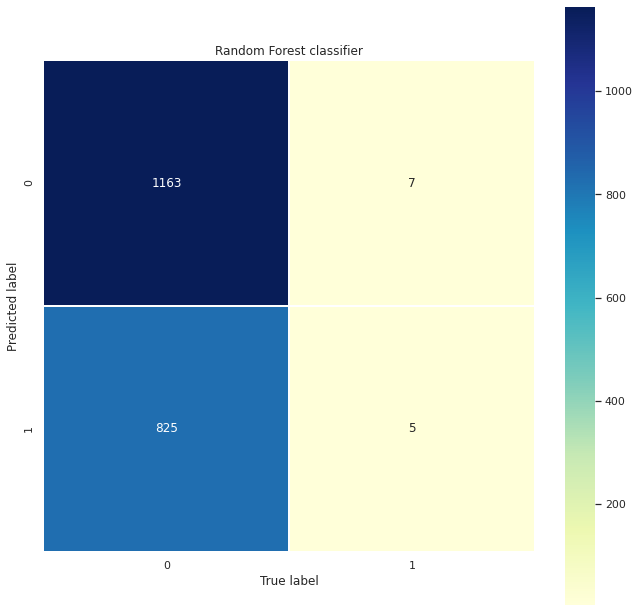

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1170
           1       0.42      0.01      0.01       830

    accuracy                           0.58      2000
   macro avg       0.50      0.50      0.37      2000
weighted avg       0.52      0.58      0.44      2000

Classifier = Neural Net, Score (test, accuracy) = 58.50, Training time = 1.74 seconds


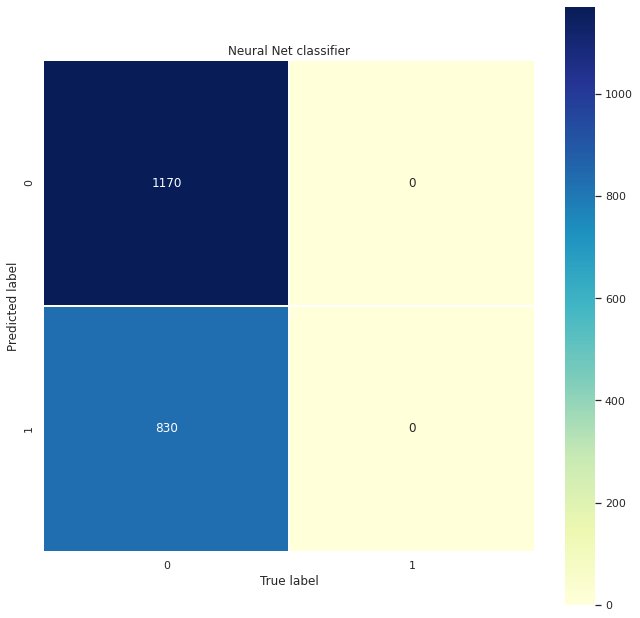

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.58      1.00      0.74      1170
           1       0.00      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.29      0.50      0.37      2000
weighted avg       0.34      0.58      0.43      2000

Classifier = AdaBoost, Score (test, accuracy) = 58.35, Training time = 0.27 seconds


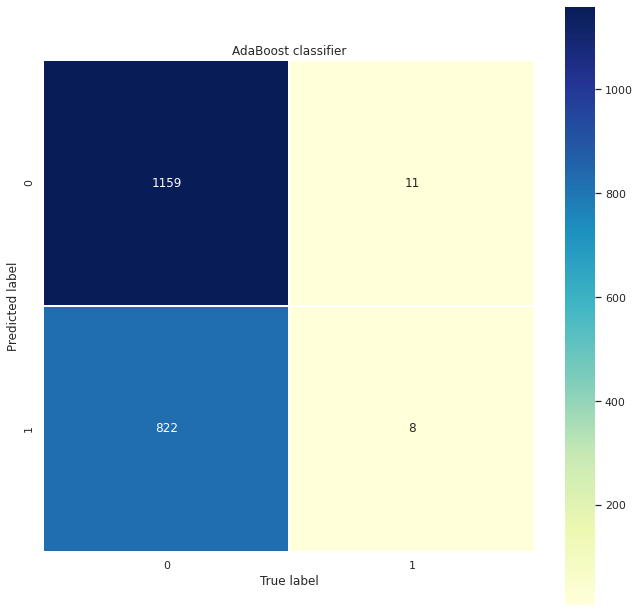

              precision    recall  f1-score   support

           0       0.59      0.99      0.74      1170
           1       0.42      0.01      0.02       830

    accuracy                           0.58      2000
   macro avg       0.50      0.50      0.38      2000
weighted avg       0.52      0.58      0.44      2000

Classifier = Naive Bayes, Score (test, accuracy) = 58.50, Training time = 0.00 seconds


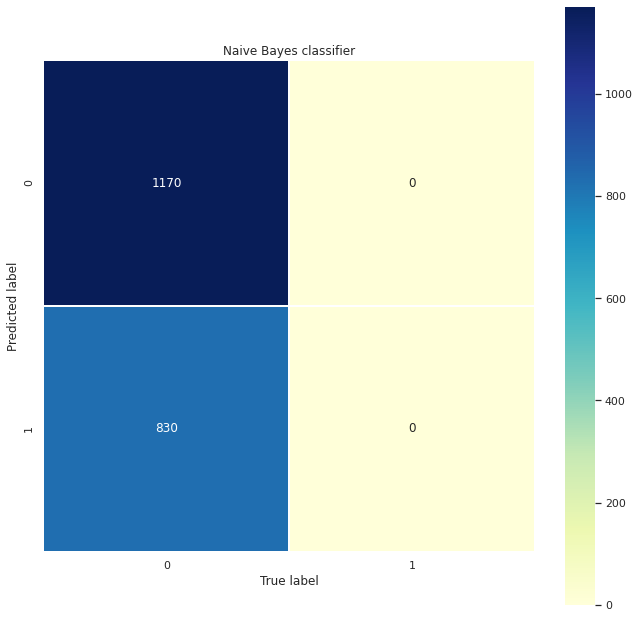

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.58      1.00      0.74      1170
           1       0.00      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.29      0.50      0.37      2000
weighted avg       0.34      0.58      0.43      2000

Classifier = QDA, Score (test, accuracy) = 58.50, Training time = 0.00 seconds


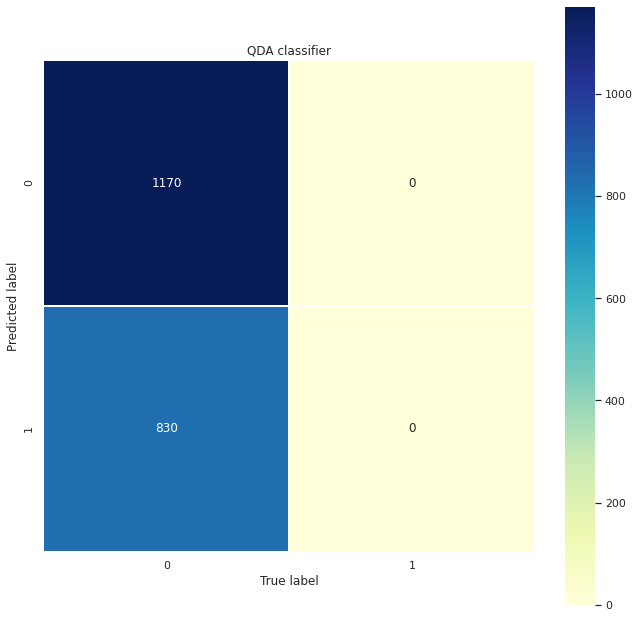

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.58      1.00      0.74      1170
           1       0.00      0.00      0.00       830

    accuracy                           0.58      2000
   macro avg       0.29      0.50      0.37      2000
weighted avg       0.34      0.58      0.43      2000

Classifier = XGBoost, Score (test, accuracy) = 57.75, Training time = 0.24 seconds


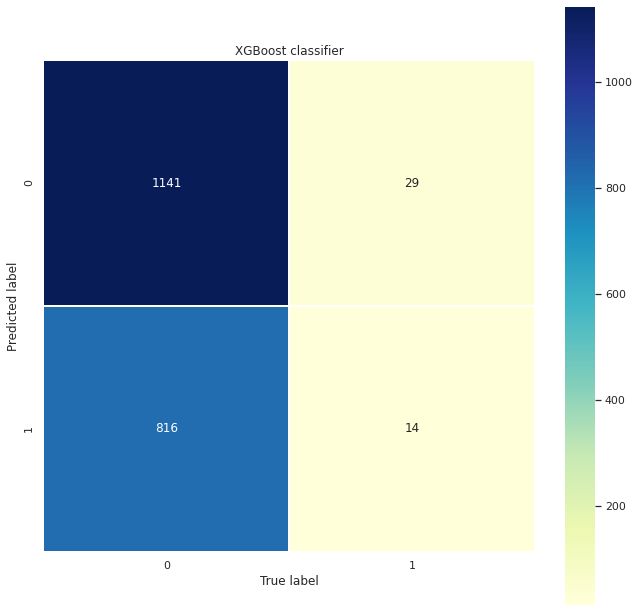

              precision    recall  f1-score   support

           0       0.58      0.98      0.73      1170
           1       0.33      0.02      0.03       830

    accuracy                           0.58      2000
   macro avg       0.45      0.50      0.38      2000
weighted avg       0.48      0.58      0.44      2000

--------------------------------------------------------------------------------
Best --> Classifier = Linear SVM, Score (test, accuracy) = 58.50


In [ ]:
import time
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    # GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)]

log_cols=["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)
max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time.time()
    #start_time = datetime.datetime.now().time()
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test) 
    score = 100.0 * clf.score(x_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time.time() - start_time))
    mat_RFC = confusion_matrix(y_test, y_pred)

    fig, ax = plt.subplots(figsize=(11,11))  
    ax.set_title(name + " " +"classifier")
    sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
    plt.xlabel('True label')
    plt.ylabel('Predicted label');
    plt.show()

    cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
    print(cls_RFC)


    
    log_entry = pd.DataFrame([[name,score]], columns=log_cols)
    log = log.append(log_entry)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

For Random forest classifier

In [ ]:
# Random Forest
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
randomforest = RandomForestClassifier()
randomforest.fit(x_train, y_train)
y_pred = randomforest.predict(x_test)
y_pred_proba1 = randomforest.predict_proba(x_test)[:, 1]
acc_randomforest = round(accuracy_score(y_pred, y_test) * 100, 2)
print("Random Forest Accuracy: " ,acc_randomforest)

Random Forest Accuracy:  52.85


              precision    recall  f1-score   support

           0       0.59      0.61      0.60      1170
           1       0.43      0.41      0.42       830

    accuracy                           0.53      2000
   macro avg       0.51      0.51      0.51      2000
weighted avg       0.53      0.53      0.53      2000



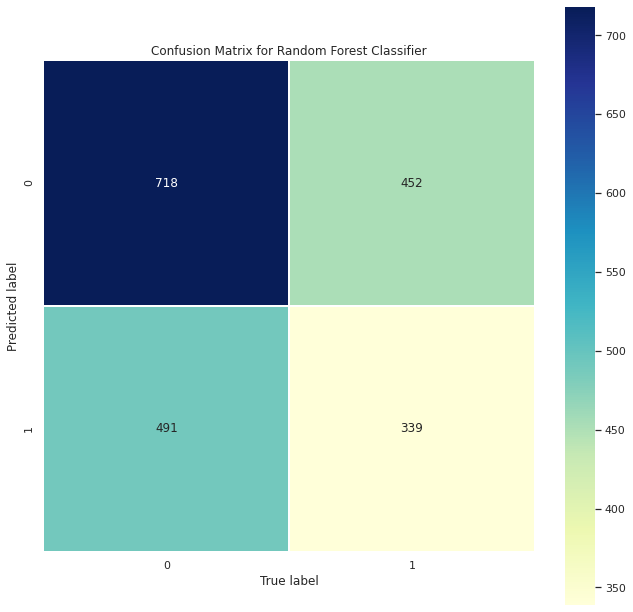

In [ ]:
mat_RFC = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(11,11))  
ax.set_title("Confusion Matrix for Random Forest Classifier")
sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
plt.xlabel('True label')
plt.ylabel('Predicted label');

cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
print(cls_RFC)

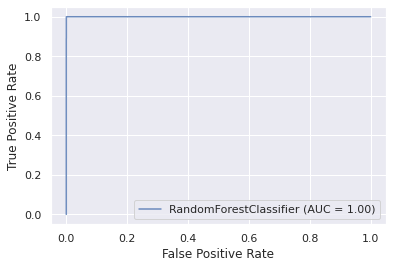

In [ ]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
mat_RFC = plot_roc_curve(randomforest, x_train, y_train, ax=ax, alpha=0.8)
plt.show()

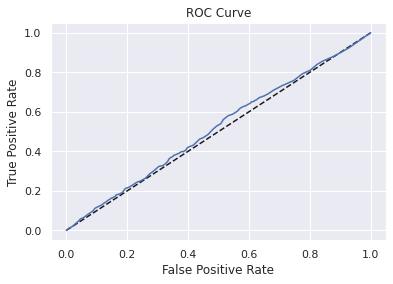

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba2, pos_label=1)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
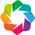

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()

In [ ]:
### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
       
    return out

# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)
optimal = data[np.argmax(data[:,7])]

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,320,480,482,718,.60,0.58,.59])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# for the AUC, we need only plot our FP vs TP
hv.Curve(data[:]). \
   opts(xrotation=45,
        xlabel='False Positive',
        ylabel='True Positive'
       )
   
# for the PR curve, we need only plot recall vs precision
hv.Curve(data[:,[6,5]]). \
   opts(xlim=(0,1),
        ylim=(0,1)
       )

:Curve   [x]   (y)

###Widget Slider

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
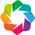

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba1, y_test)
dash.show()

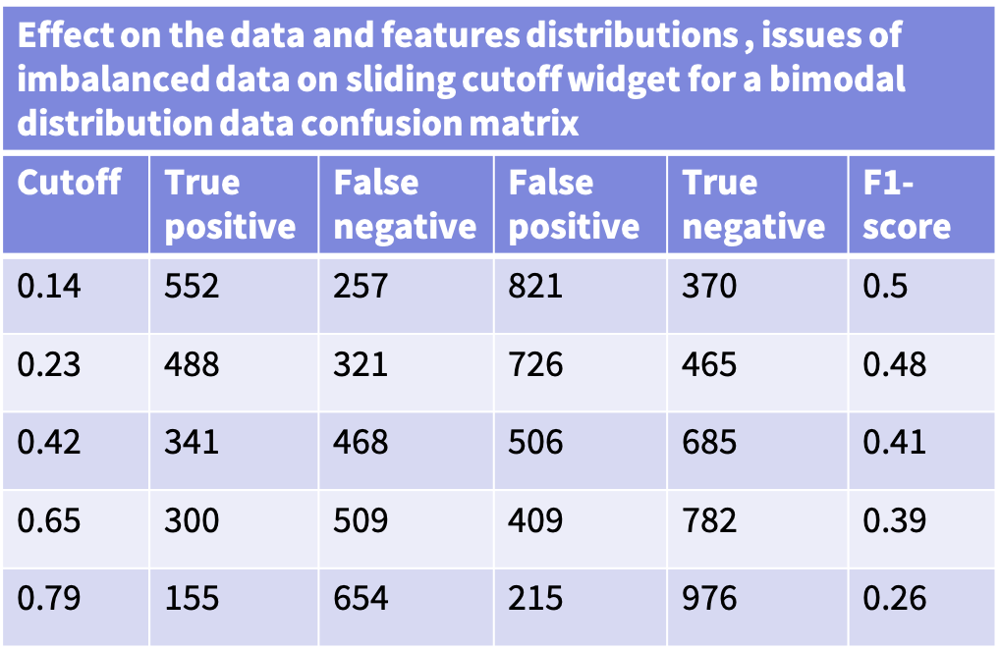

##Randomly distributed data

In [ ]:
def genAccountBalance(size = 4, low = 300, high = 850):
    arr = np.random.randint(low,high,size)                  # generate random integers
    arr = np.clip(arr, 300, 850)                                       # clip respecting boundaries
    return (arr)

In [ ]:
def genDataset(size = 10000):
    data = {'Name': genName(size),
            'Email': genEmail(size),
            'Company': genCompany(size),
            'AccountBalance': genAccountBalance(size),
            'Gender': genGender(size)}
    return (pd.DataFrame(data))

# generate the fake data and save the csv and excel files
df = genDataset()
df.to_csv('dataset.csv', index = False)

###Scattered plot that shows randomly distributed account balance data

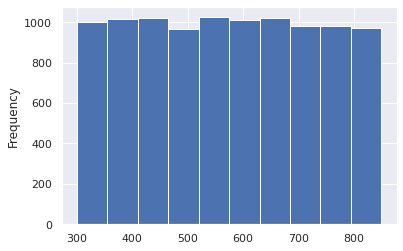

In [ ]:
AccBalance_column = df["AccountBalance"]
AccBalance_column.plot(kind="hist")

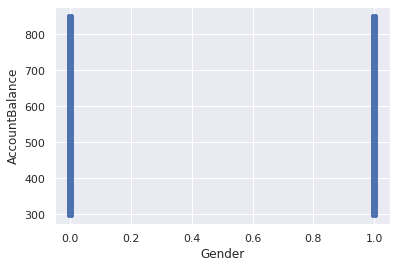

In [ ]:
# Selecting the X axis and Y axis from the data by inserting location of the columns from the data
X = df.iloc[:, [3, 4]].values

#Plotting the selected data
plt.scatter(df['Gender'],df['AccountBalance'])
plt.xlabel('Gender')
plt.ylabel('AccountBalance')
plt.show()

In [ ]:
target_data = df.drop(['Name','Email','Company'], axis=1)
target_data

,AccountBalance,Gender
0,543,0
1,673,1
2,558,1
3,764,0
4,302,1
...,...,...
9995,816,0
9996,586,1
9997,554,0
9998,502,1


In [ ]:
unscaled_data = target_data.iloc[:,:-1]
unscaled_data

,AccountBalance
0,543
1,673
2,558
3,764
4,302
...,...
9995,816
9996,586
9997,554
9998,502


In [ ]:
targets=np.array(df['Gender'])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(unscaled_data)
scaled_inputs = scaler.transform(unscaled_data)
scaled_inputs

array([[-0.18857963],
       [ 0.63249616],
       [-0.09384012],
       ...,
       [-0.11910399],
       [-0.44753431],
       [-1.59704041]])

In [ ]:
scaled_inputs.shape

(10000, 1)

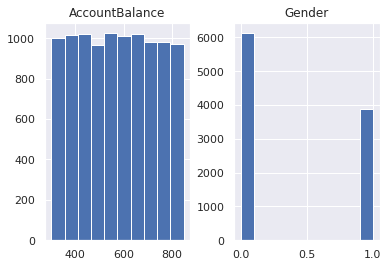

In [ ]:
import matplotlib.pyplot as plt
import pandas
df.hist()
plt.show()

###Applying Muller loop

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier


names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", #"Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA","XGBoost"]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_inputs, targets, train_size = 0.8)
#X_train = np.array(x_train)
#y_train = np.array(y_train)
#x_test = np.array(x_test)
#y_test = np.array(y_test)

In [ ]:
ylabel = df['Gender'].unique()
ylabels = ["1" if x == 1 else "0" for x in ylabel]
ylabels

['0', '1']

Classifier = Nearest Neighbors, Score (test, accuracy) = 56.95, Training time = 0.11 seconds


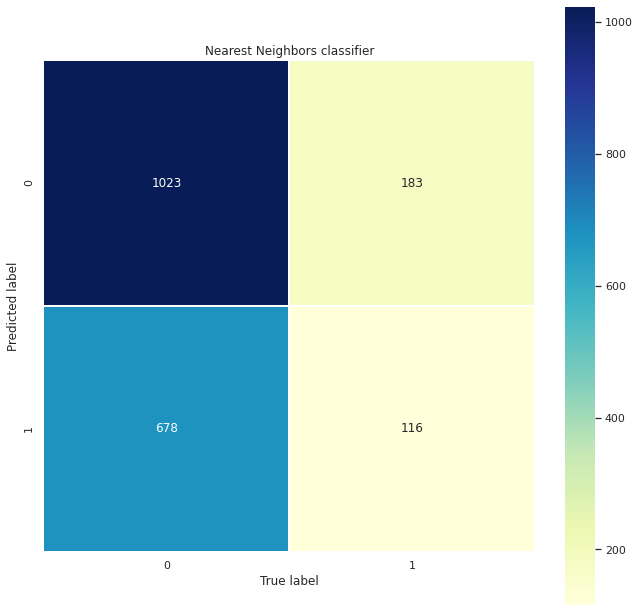

              precision    recall  f1-score   support

           0       0.60      0.85      0.70      1206
           1       0.39      0.15      0.21       794

    accuracy                           0.57      2000
   macro avg       0.49      0.50      0.46      2000
weighted avg       0.52      0.57      0.51      2000

Classifier = Linear SVM, Score (test, accuracy) = 60.30, Training time = 1.08 seconds


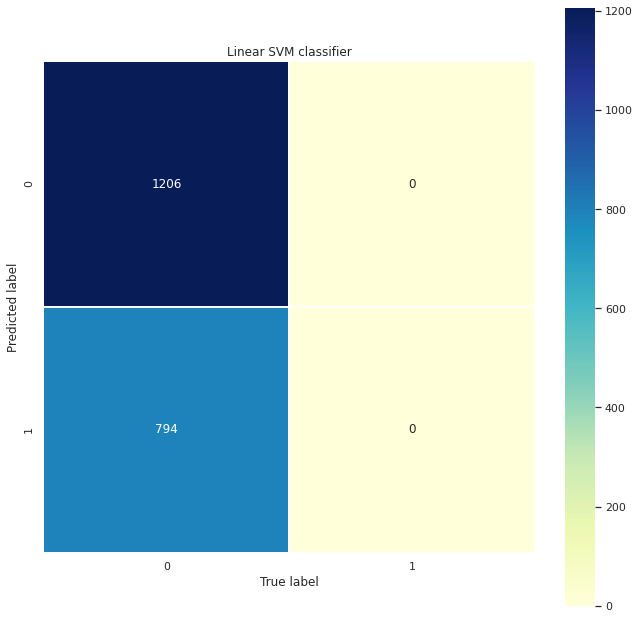

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = RBF SVM, Score (test, accuracy) = 60.30, Training time = 2.40 seconds


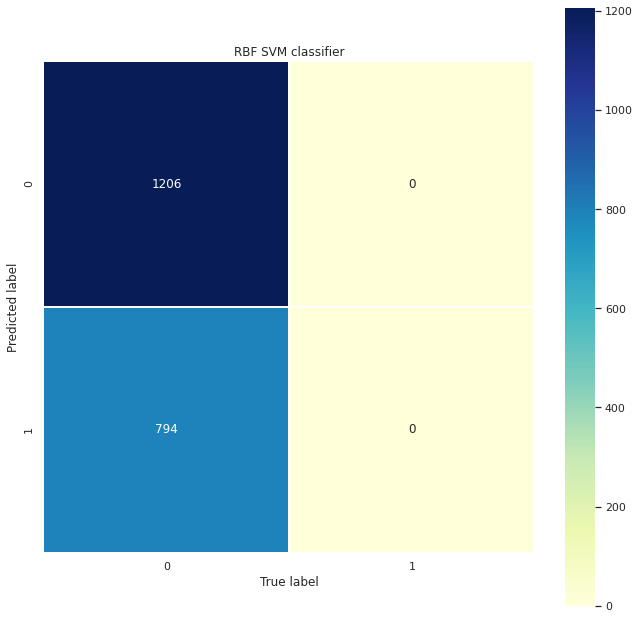

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = Decision Tree, Score (test, accuracy) = 59.80, Training time = 0.01 seconds


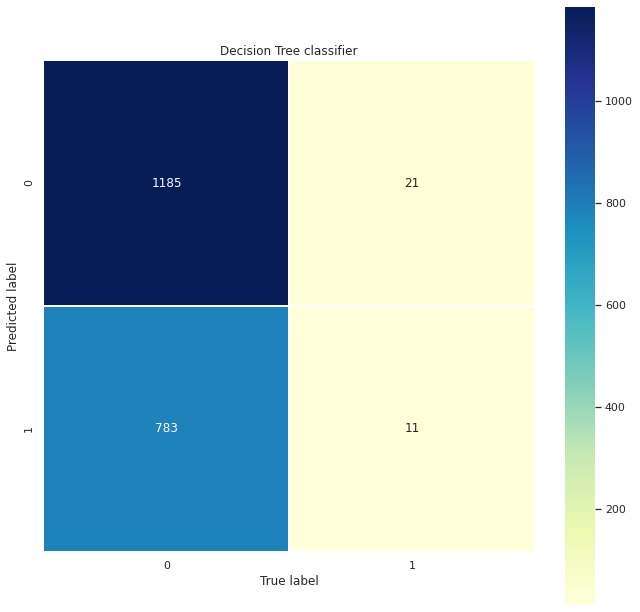

              precision    recall  f1-score   support

           0       0.60      0.98      0.75      1206
           1       0.34      0.01      0.03       794

    accuracy                           0.60      2000
   macro avg       0.47      0.50      0.39      2000
weighted avg       0.50      0.60      0.46      2000

Classifier = Random Forest, Score (test, accuracy) = 60.30, Training time = 0.06 seconds


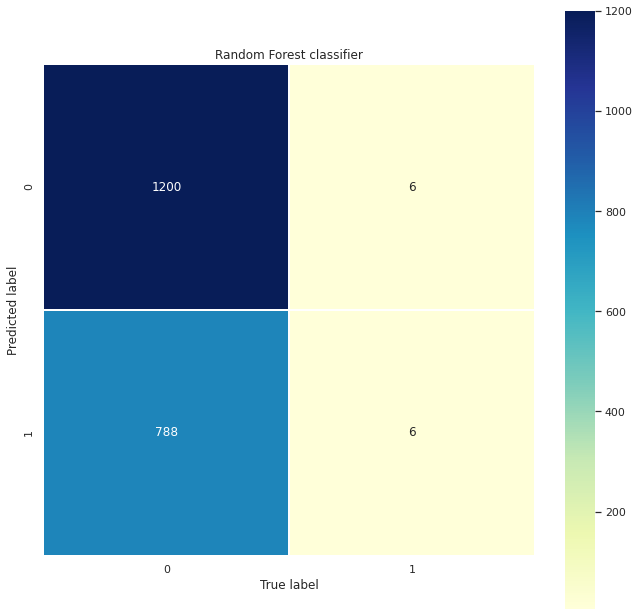

              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.50      0.01      0.01       794

    accuracy                           0.60      2000
   macro avg       0.55      0.50      0.38      2000
weighted avg       0.56      0.60      0.46      2000

Classifier = Neural Net, Score (test, accuracy) = 60.30, Training time = 1.42 seconds


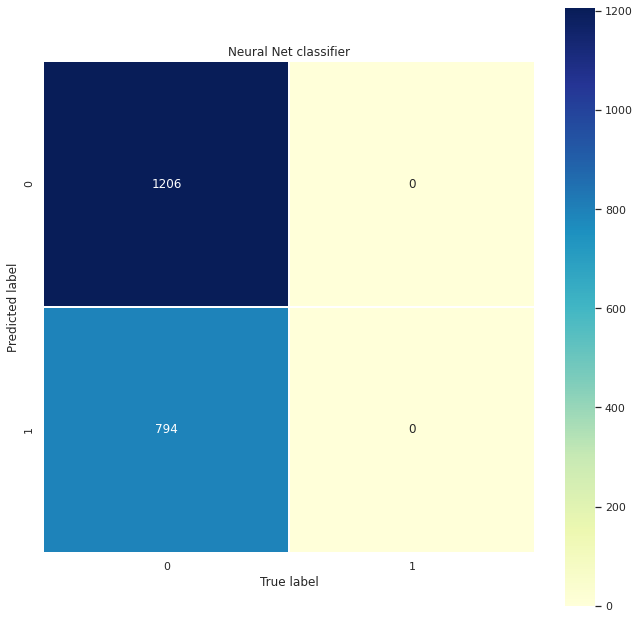

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = AdaBoost, Score (test, accuracy) = 60.30, Training time = 0.25 seconds


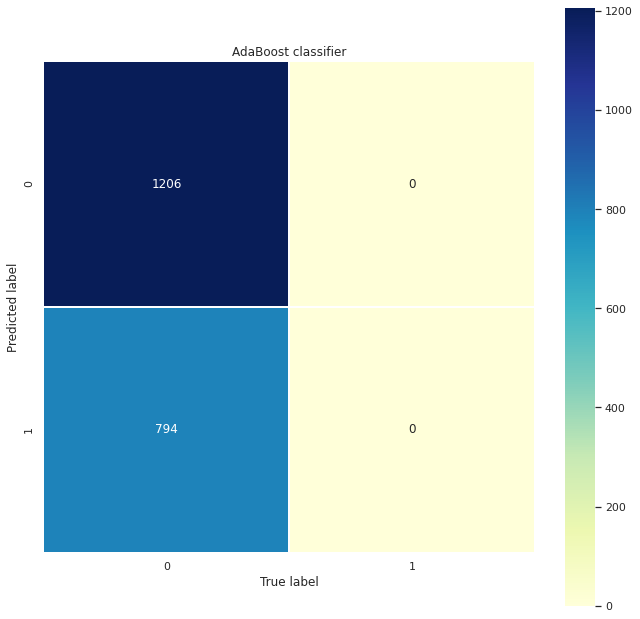

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = Naive Bayes, Score (test, accuracy) = 60.30, Training time = 0.00 seconds


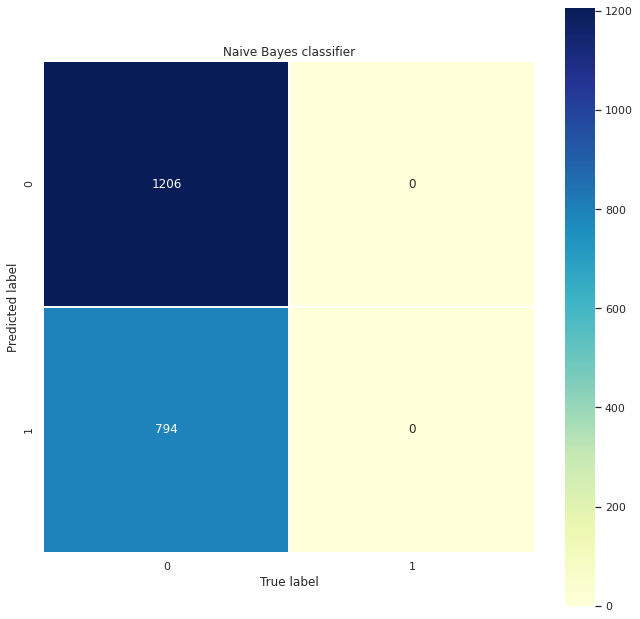

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = QDA, Score (test, accuracy) = 60.30, Training time = 0.00 seconds


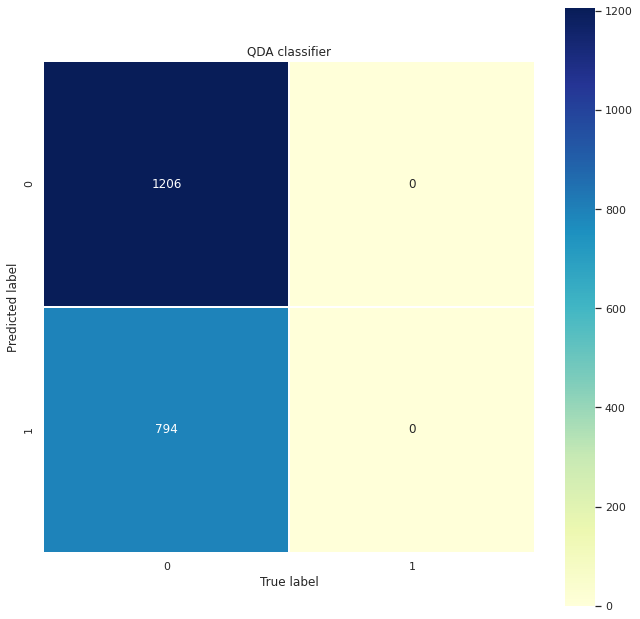

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.60      1.00      0.75      1206
           1       0.00      0.00      0.00       794

    accuracy                           0.60      2000
   macro avg       0.30      0.50      0.38      2000
weighted avg       0.36      0.60      0.45      2000

Classifier = XGBoost, Score (test, accuracy) = 60.40, Training time = 0.21 seconds


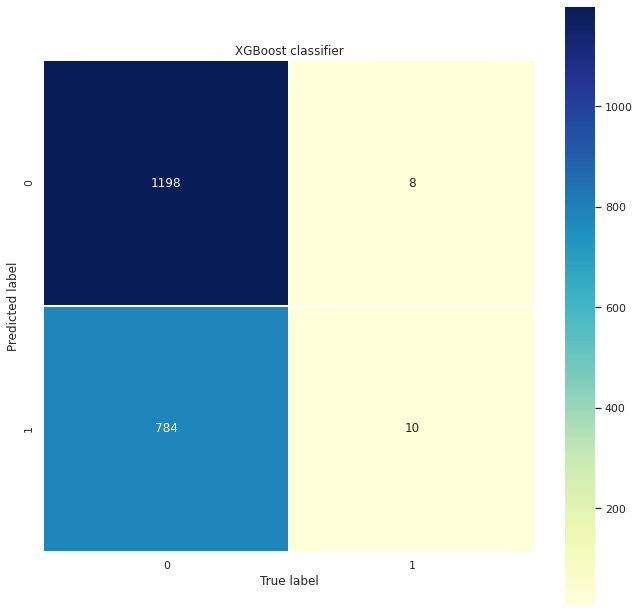

              precision    recall  f1-score   support

           0       0.60      0.99      0.75      1206
           1       0.56      0.01      0.02       794

    accuracy                           0.60      2000
   macro avg       0.58      0.50      0.39      2000
weighted avg       0.59      0.60      0.46      2000

--------------------------------------------------------------------------------
Best --> Classifier = XGBoost, Score (test, accuracy) = 60.40


In [ ]:
import time
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    # GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)]

log_cols=["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)
max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time.time()
    #start_time = datetime.datetime.now().time()
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test) 
    score = 100.0 * clf.score(x_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time.time() - start_time))
    mat_RFC = confusion_matrix(y_test, y_pred)

    fig, ax = plt.subplots(figsize=(11,11))  
    ax.set_title(name + " " +"classifier")
    sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
    plt.xlabel('True label')
    plt.ylabel('Predicted label');
    plt.show()

    cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
    print(cls_RFC)


    
    log_entry = pd.DataFrame([[name,score]], columns=log_cols)
    log = log.append(log_entry)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

For Random forest classifier

In [ ]:
# Random Forest
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns; sns.set() 
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
randomforest = RandomForestClassifier()
randomforest.fit(x_train, y_train)
y_pred = randomforest.predict(x_test)
y_pred_proba4 = randomforest.predict_proba(x_test)[:, 1]
acc_randomforest = round(accuracy_score(y_pred, y_test) * 100, 2)
print("Random Forest Accuracy: " ,acc_randomforest)

Random Forest Accuracy:  56.25


              precision    recall  f1-score   support

           0       0.60      0.79      0.69      1206
           1       0.40      0.21      0.28       794

    accuracy                           0.56      2000
   macro avg       0.50      0.50      0.48      2000
weighted avg       0.52      0.56      0.52      2000



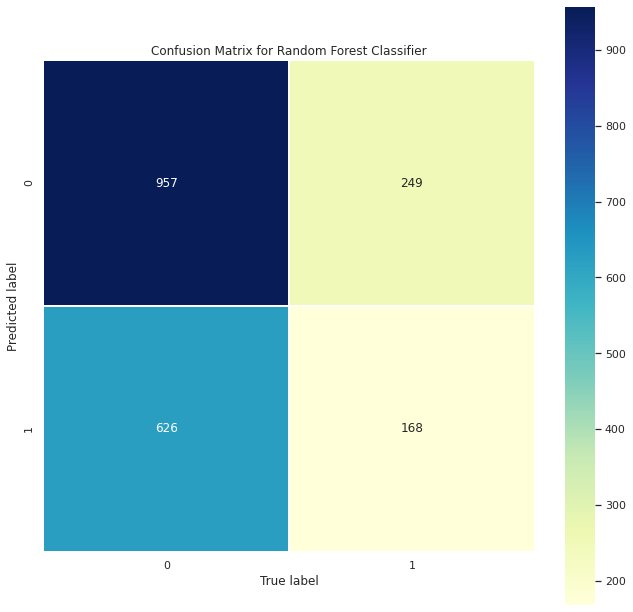

In [ ]:
mat_RFC = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(11,11))  
ax.set_title("Confusion Matrix for Random Forest Classifier")
sns.heatmap(mat_RFC, square=True, annot=True, fmt='d', cbar=True,cmap="YlGnBu",
            xticklabels=ylabels,
            yticklabels=ylabels,linewidths=.5, ax=ax)
plt.xlabel('True label')
plt.ylabel('Predicted label');

cls_RFC = classification_report(y_test, y_pred, target_names=ylabels)
print(cls_RFC)

###Plotting ROC curve

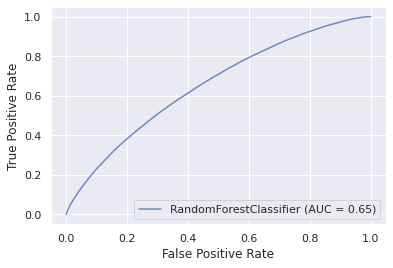

In [ ]:
from sklearn.metrics import plot_roc_curve
ax = plt.gca()
mat_RFC = plot_roc_curve(randomforest, x_train, y_train, ax=ax, alpha=0.8)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
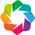

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()

In [ ]:
### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
       
    return out

# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)
optimal = data[np.argmax(data[:,7])]

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,914,640,272,513,0.59,0.77,0.67])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# for the AUC, we need only plot our FP vs TP
hv.Curve(data[:]). \
   opts(xrotation=45,
        xlabel='False Positive',
        ylabel='True Positive'
       )
   
# for the PR curve, we need only plot recall vs precision
hv.Curve(data[:,[6,5]]). \
   opts(xlim=(0,1),
        ylim=(0,1)
       )

:Curve   [x]   (y)

###Widget slider

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
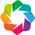

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba4, y_test)
dash.show()

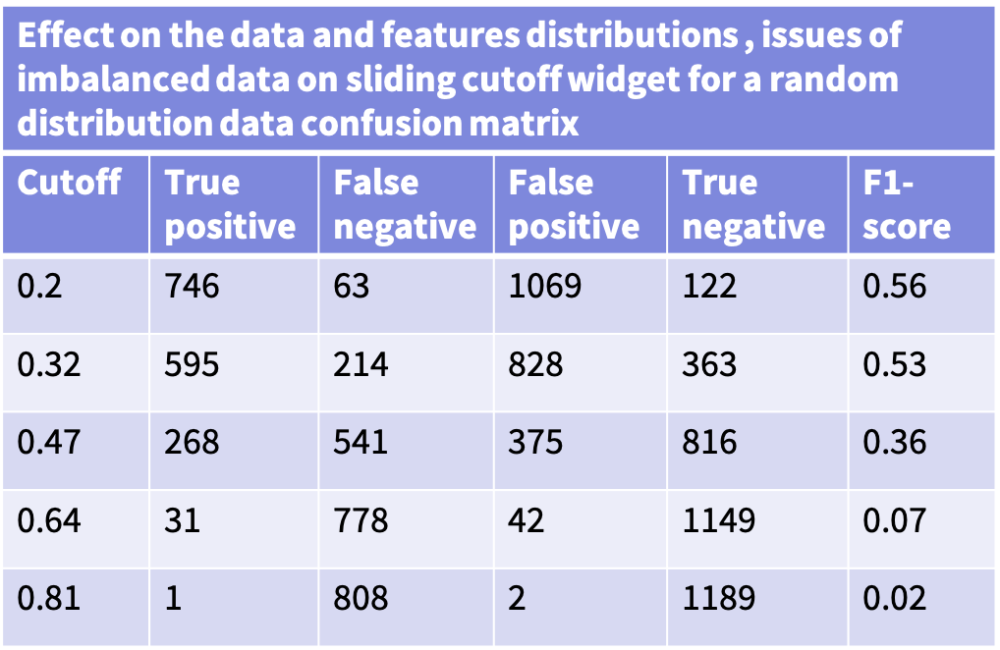

# Dashboard for confusion matrix with sliders

###Normal distribution confusion matrix

Below is the interactive confusion matrix for normally distributed data. While changing the values of the cutoff score in the slider, I observed that As we increase slider with the cutoff scores, there is reduction in the f1 score. And the predicted and actual value quadrant shows the following. **True positive and False Positive** is decreasing, **False Negative and True negative** is increasing

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
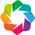

Column
    [0] Row
        [0] FloatSlider(step=0.001, value=0.05)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
# ### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
         
    return out
    
# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)

optimal = data[np.argmax(data[:,7])]
# print(data[np.argmax(data[:,7])])

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,809,494,423,274,.62,0.66,.64])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# # for the AUC, we need only plot our FP vs TP
# hv.Curve(data[:,[3,1]]). \
#    opts(xrotation=45,
#         xlabel='False Positive',
#         ylabel='True Positive'
#        )
   

# # for the PR curve, we need only plot recall vs precision
# hv.Curve(data[:,[6,5]]). \
#    opts(xlim=(0,1),
#         ylim=(0,1)
#        )
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        # print("curr_val", curr_val)
        curr_idx = int(curr_val * 1000)
        # print("curr_idx", curr_idx)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))
        # print(data)
        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba3, y_test)
dash.show()

###Uniform distribution confusion matrix


Below is the interactive confusion matrix for uniformly distributed data. While changing the values of the cutoff score in the slider, I observed that As we increase slider with the cutoff scores, there is reduction in the f1 score. And the predicted and actual value quadrant shows the following. **True positive and False Positive** is decreasing, **False Negative and True negative** is increasing. This means, as we increase the cutoff score, the account balances of female is becoming more.
In addition to this, uniform distributed data changes are more when compared to normal distributed  

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
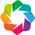

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
# ### helper funcs, optimized by numba ###

# generates hard predictions
@nb.njit
def pred_to_hard(val, arr):
    arr[arr > val] = 1
    arr[arr <= val] = 0
    return arr

# generates f1 score
@nb.njit
def f1_test(true, pred):
    # precision
    tp = pred[(true == 1) & (true == pred)].sum()
    pred_pos = (pred == 1).sum()
    pr = tp / pred_pos
    # recall
    actl_pos = (true == 1).sum()
    rc = tp / actl_pos
    return 2 * (pr * rc) / (pr + rc)

@nb.njit(parallel=True)
def gen_all_stats(pred, true):
    # initialize output, 1000 rows (.001 steps)
    out = np.zeros((1000,8))   
    for i in nb.prange(1000):
        cutoff = i / 1000.0
        hard = pred_to_hard(cutoff, pred.copy()).astype(np.int8)
        tp = np.sum((hard == 1) & (true == 1))
        tn = np.sum((hard == 0) & (true == 0))
        fp = np.sum((hard == 1) & (true == 0))
        fn = np.sum((hard == 0) & (true == 1))
        pr = tp / (hard == 1).sum()
        re = tp / (true == 1).sum()
        f1 = f1_test(true, hard)
        out[i] = np.array([cutoff,tp,fn,fp,tn,pr,re, f1])
         
    return out
    
# Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
data = gen_all_stats(y_pred, y_test)

optimal = data[np.argmax(data[:,7])]
# print(data[np.argmax(data[:,7])])

### widgets ###
slider = pn.widgets.FloatSlider(start=0,
                                end=1,
                                step=.001, 
                                value = optimal[0])

default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
              format(*optimal[[0,7]])
md = pn.pane.Markdown(default_txt)

### layout ###
layout = pn.WidgetBox(slider, md)

### callbacks ###
def slider_update(event):
    curr_val = slider.value
    curr_idx = int(1000 * curr_val)
    f1 = data[curr_idx, 7]
    md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                     format(curr_val, f1)

### watchers ###
slider.param.watch(slider_update, 'value')
    
layout

# we'll use some made up data for now
# In order, these are: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
optimal = np.array([.348,809,494,423,274,.62,0.66,.64])

# we need to use some weird indexing to get the values in the right spot
pos = [(0,1),(1,1),(0,0),(1,0)]
labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
hm_data = list(map(lambda tup,i: tup + (i,), 
                   pos, 
                   optimal[1:5].astype(int)))
label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                      pos,
                      labels,
                      optimal[1:5].astype(int)))

hm = hv.HeatMap(hm_data). \
    opts(cmap=cm.Blues,
         colorbar=False,
         xaxis='bare',
         yaxis='bare',
         height=512,
         width=512,
        )

hm*hv.Labels(label_data)


# # for the AUC, we need only plot our FP vs TP
# hv.Curve(data[:,[3,1]]). \
#    opts(xrotation=45,
#         xlabel='False Positive',
#         ylabel='True Positive'
#        )
   

# # for the PR curve, we need only plot recall vs precision
# hv.Curve(data[:,[6,5]]). \
#    opts(xlim=(0,1),
#         ylim=(0,1)
#        )
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        # print("curr_val", curr_val)
        curr_idx = int(curr_val * 1000)
        # print("curr_idx", curr_idx)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))
        # print(data)
        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba2, y_test)
dash.show()


###Bimodal distribution confusion matrix

Below is the interactive confusion matrix for uniformly distributed data. While changing the values of the cutoff score in the slider, I observed that As we increase slider with the cutoff scores, there is reduction in the f1 score. And the predicted and actual value quadrant shows the following. **True positive and False Positive** is decreasing, **False Negative and True negative** is increasing. This means,when cutoff score is less, the account balances of male is more and reduces as we progress.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
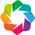

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba1, y_test)
dash.show()

###Random distributed data

Below is the interactive confusion matrix for uniformly distributed data. While changing the values of the cutoff score in the slider, I observed that As we increase slider with the cutoff scores, there is reduction in the f1 score. And the predicted and actual value quadrant shows the following. **True positive and False Positive** is rapidly decreasing, **False Negative and True negative** is increasing. This means, as we increase the cutoff score, the account balances of female is becoming more.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
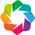

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba4, y_test)
dash.show()

###Exponential data distribution

Below is the interactive confusion matrix for uniformly distributed data. While changing the values of the cutoff score in the slider, I observed that As we increase slider with the cutoff scores, there is reduction in the f1 score. And the predicted and actual value quadrant shows the following. **True positive and False Positive** is decreasing, **False Negative and True negative** is gradually increasing. This means, as we increase the cutoff score, the account balances of female is becoming more.
In addition to this, uniform distributed data changes are more when compared to normal distributed 

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
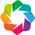

Column
    [0] Row
        [0] FloatSlider(step=0.001)
        [1] Markdown(str)
    [1] Row
        [0] HoloViews(Overlay)
        [1] HoloViews(Overlay)
        [2] HoloViews(Overlay)

In [ ]:
import numpy as np
import numba as nb
import holoviews as hv
import panel as pn

from matplotlib import cm

hv.extension('bokeh', 'matplotlib')
pn.extension()
class ClassificationDash():
    def __init__(self, pred, true):
        ### data ###
        self.pred = pred.copy()
        self.true = true.copy()
        # Cols: Cutoff, True Pos, False Neg, False Pos, True Neg, Precision, Recall, F1
        self.data = gen_all_stats(self.pred, self.true)
        self.init_idx = np.argmax(self.data[:,7])
        self.optimal = self.data[self.init_idx]
                
        ### widgets ###
        self.slider = pn.widgets.FloatSlider(start=0,
                                             end=1,
                                             step=.001, 
                                             value = self.optimal[0])
        default_txt = 'Cutoff @ <b>{:.3}</b> \n\n F1-Score:{:.6}'. \
                      format(*self.optimal[[0,7]])
        self.md = pn.pane.Markdown(default_txt)
        self.cm = self.gen_cm(self.optimal[1:5].astype(int))
        self.auc = self.gen_auc(self.init_idx)
        self.pr = self.gen_pr(self.init_idx)
        
        ### layout ###
        self.row_01 = pn.layout.Row(self.slider,self.md)
        self.row_02 = pn.layout.Row(self.cm, self.auc, self.pr)
        self.layout = pn.layout.Column(self.row_01,self.row_02)
        '''
        self.layout = pn.WidgetBox(self.slider, 
                                   self.md, 
                                   self.hm,
                                   self.auc,
                                   self.pr
                                  )
        '''
        ### watchers ###
        self.slider.param.watch(self.slider_update, 'value')

    ### callbacks ###
    def slider_update(self, event):
        curr_val = self.slider.value
        curr_idx = int(curr_val * 1000)
        f1 = f1_test(self.true, 
                     pred_to_hard(curr_val, self.pred.copy()))
        self.md.object = 'Cutoff @ <b>{:.3}</b>  \n\n F1-Score:{:.6}'. \
                         format(curr_val, f1)
        self.row_02[0].object = self.gen_cm(self.data[curr_idx,1:5].astype(int))
        self.row_02[1].object = self.gen_auc(curr_idx)
        self.row_02[2].object = self.gen_pr(curr_idx)
        
    ### plotting funcs: this lets us update plots ###
    def gen_cm(self, data):
        # we need to use some weird indexing to get the values in the right spot
        pos = [(0,1),(1,1),(0,0),(1,0)]
        labels = ['True Positive', 'False Negative', 'False Positive', 'True Negative']
        hm_data = list(map(lambda tup,i: tup + (i,), 
                           pos, 
                           data))
        label_data = list(map(lambda tup,lab,i: tup + ('{}\n{}'.format(lab,i),),
                              pos,
                              labels,
                              data))

        hm = hv.HeatMap(hm_data). \
            opts(cmap=cm.Blues,
                 colorbar=False,
                 xaxis='bare',
                 yaxis='bare',
                )

        return hm*hv.Labels(label_data)
    
    def gen_auc(self, curr_idx):
        # setting limits on x for readability
        x_max = self.data[:,3].max()
        x_min = -int(x_max / 20)
        plot = hv.Curve(self.data[:,[3,1]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(x_min,x_max)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[3,1]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    def gen_pr(self, curr_idx):
        plot = hv.Curve(self.data[:,[6,5]]). \
                  opts(xrotation=45,
                       xlabel='False Positive',
                       ylabel='True Positive',
                       xlim=(-.01,1),
                       ylim=(0,1.01)
                      )
        marker = hv.Points(tuple(self.data[curr_idx,[6,5]])). \
                    opts(size=6,
                         color='Red'
                        )
        return plot * marker
    
    ### helper funcs ###
    
    def show(self):
        return self.layout


dash = ClassificationDash(y_pred_proba5, y_test)
dash.show()

###**Observations for questions asked in rubric:**
What if you changed (sliders on values in the confusion matrix) the values in the confusion matrix?

The observations are mentioned in the readings table that is added at the end of each type of distribution table

What happens to the data columns? Do the distributions on the data have to change (eg90-10 male-female on credit card dataset becomes 70-30 , increase female data rows ?


The observations are mentioned in the readings table that is added at the end of each type of distribution table

Mullerloop:

Applied mullerloop for different distributed data.

Compare them to see how the data distribution should be changed if we slide the confusion matrix FP up? What if we want to dec erase FN and increase FP, what should happen to the data to make that change come about in the confusion matrix? 

from the distribution reading tables, I observed that when we increase value of FP, there is increase in TP, f1-score and reduction in FN, TN and cutoff 

When will the algorithm going to give the best f1?  The algorithm shows its best f1 at low cutoff scores

For a given cutoff value, a positive or negative diagnosis is made for each unit by comparing the measurement to
the cutoff value.  There are four possible outcomes: true positive, true
negative, false positive, false negative. If the measurement is less (or greater, as the case may be) than the cutoff, the predicted condition
is negative. Otherwise, the predicted condition is positive. However, the predicted condition doesn’t necessarily
match the true condition of the experimental unit (patient).

##Comparison table

The below is the comparision table with some observations made when the cutoff score in each type of distribution is slided. This helps us to understand the effects on the data and features distributions , issues of imbalanced data, column counts when the widget slider is changed for different distributions.






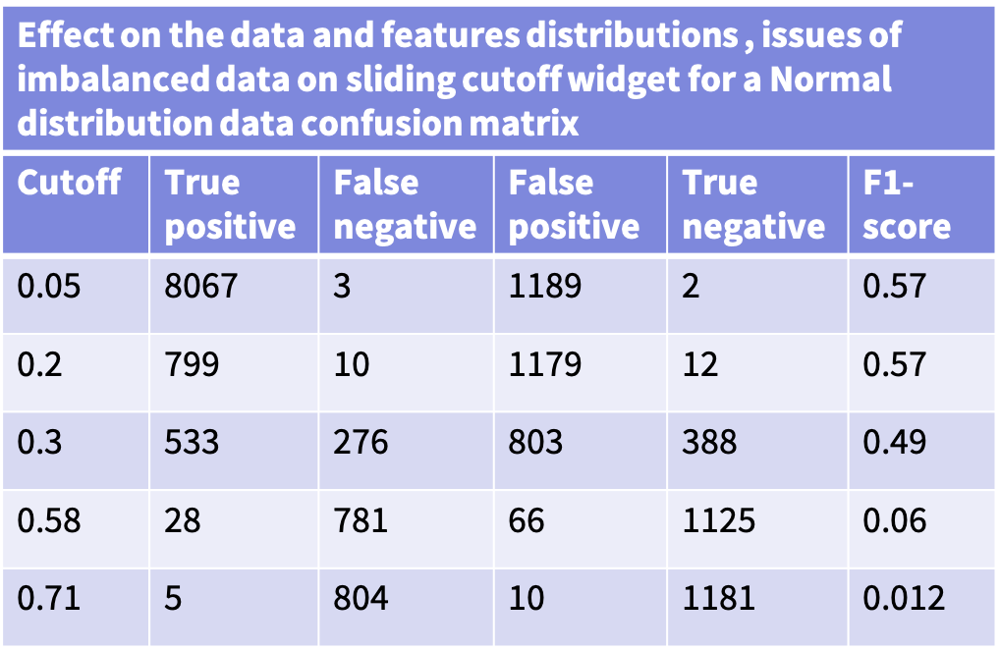



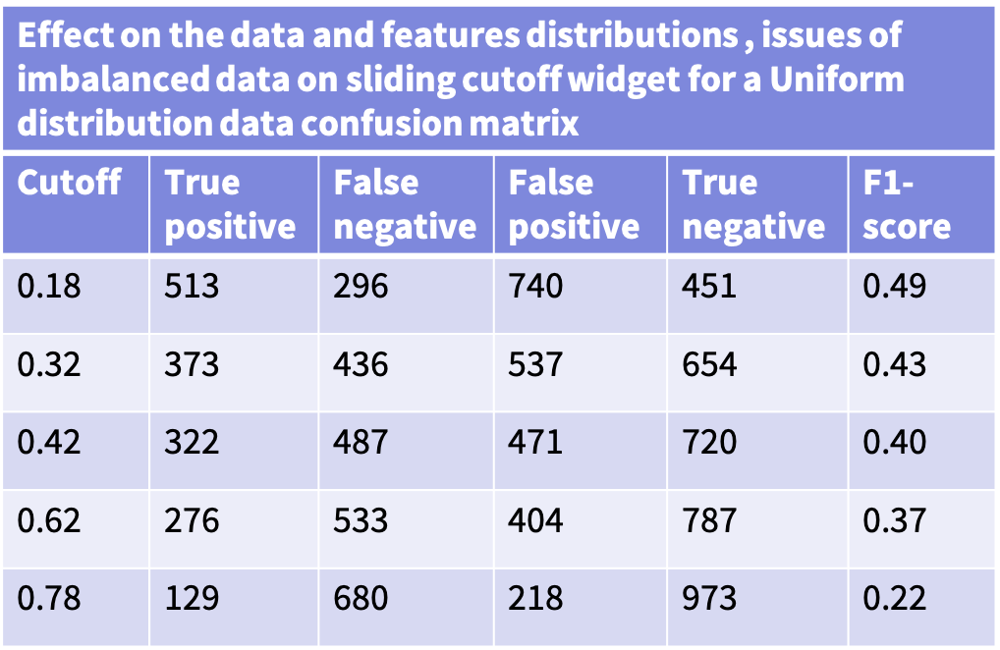


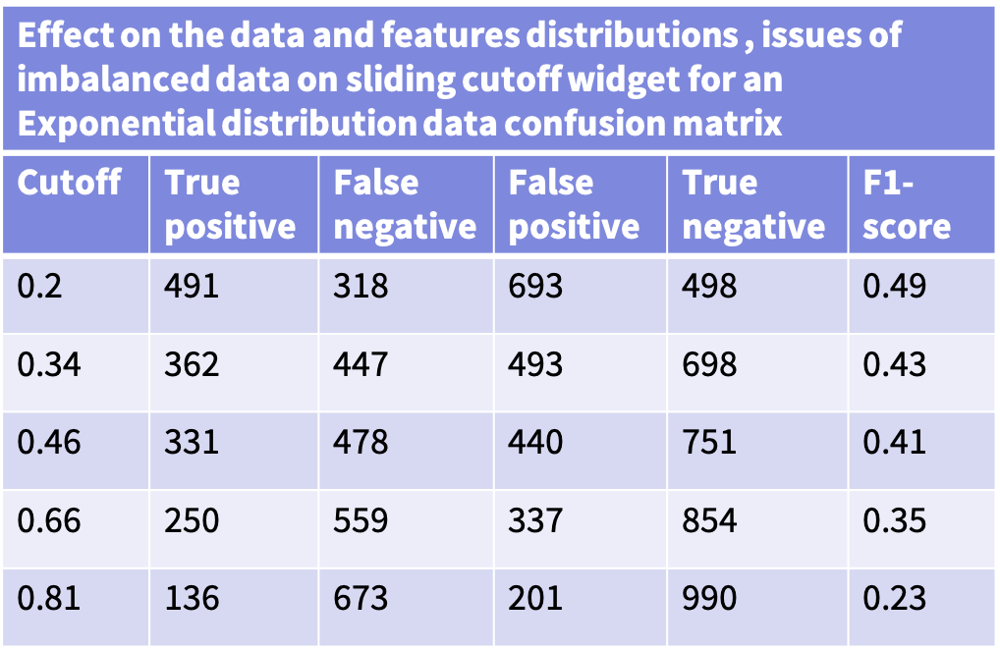

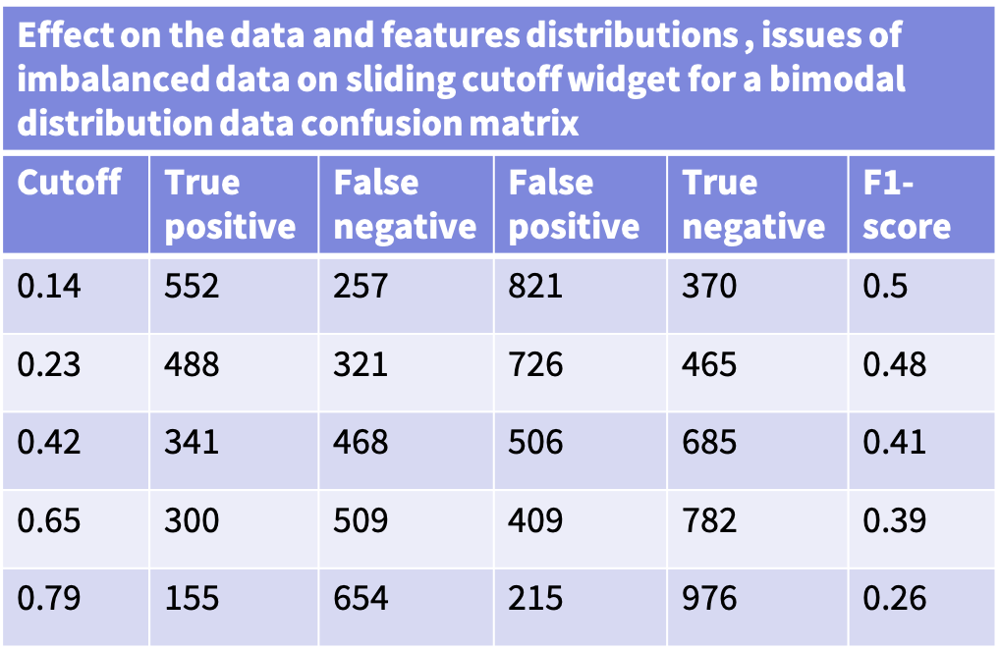

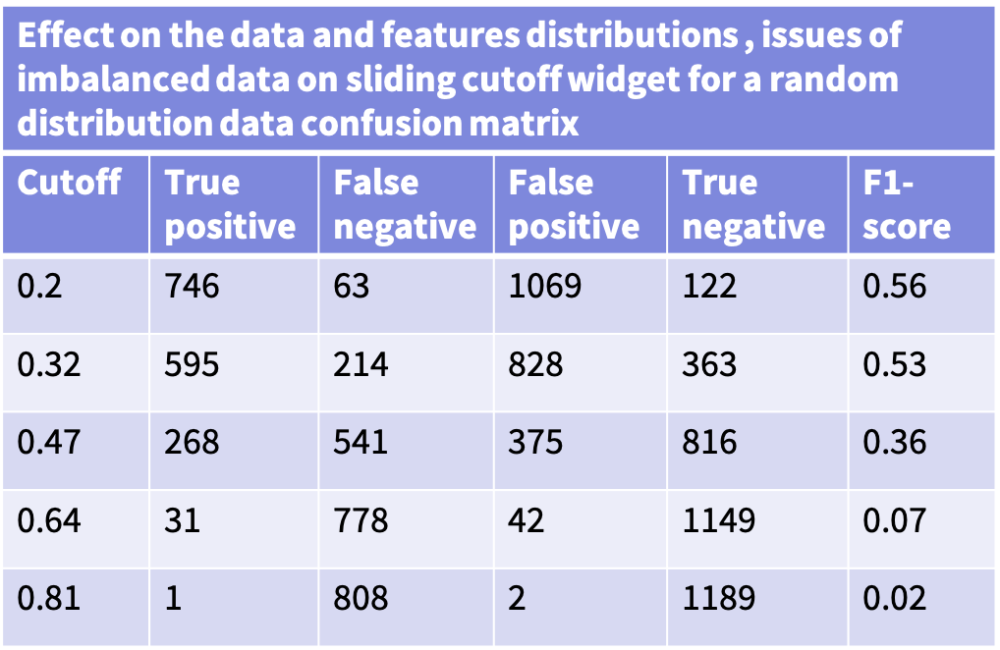


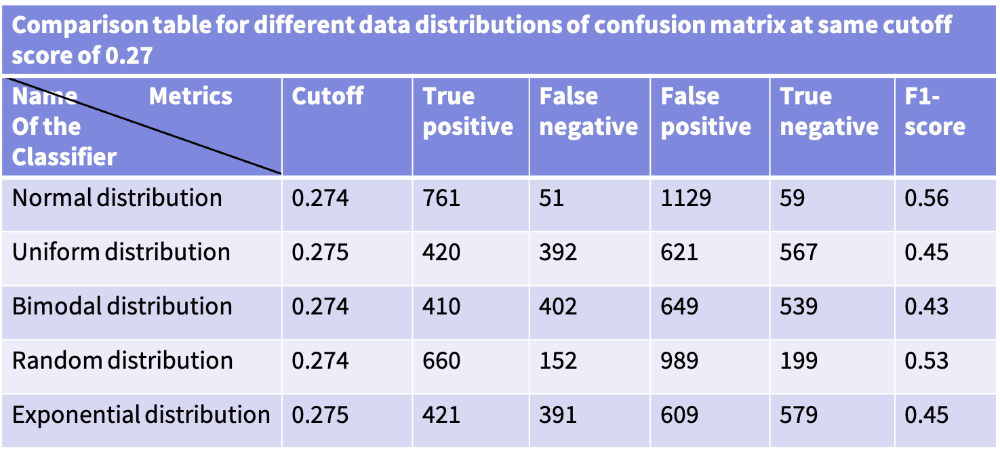

#**Conclusion**: 

Thus we created some artificial data and used a classification algorithm and few metrics to check how the metrics react to increasing skew.
Ideally without fine tuning the model or resampling the data, the suitable metrics moves from good to worse. On the other hand metrics which don’t take the skew into account did not show much change for some amount of difference, or may even show improvement with greater skew.Thus we have implemented the interactive slider for different data distributions and obtained the widget sliders.
Need for a Good Metric : Predicting the account balance
We try to predict the account balance for next day and decide on whether people  will have more or less amounts in their accounts
Lets go over some data we got from the above metrics. When cutoff score is 0.147, the values of True positive is 521, false negative is 288, false positive is 748 and true negative is 443.
That means, we have predicted correct for 521 values of balances is male, and  predicted 443 values that the balances is female and we 288 values  that the balances is female is predicted incorrect and 748 values that balances is male is predicted incorrect.This is all done to see the rate of expenditures and savings on same salary base of male and female.

Thus this interactive visualization of confusion matrix help us visualize predicted values vs actual values, Show as much of the data as quickly as possible, and Quickly get a sense of where the data lies